In [44]:
import json
import shutil

from pathlib import Path

from tqdm.notebook import tqdm

import cv2 as cv
import numpy as np
import pandas as pd
import seaborn as sns

import matplotlib.pyplot as plt

plt.rcParams["figure.figsize"] = (12, 8)
sns.set(rc={'figure.figsize':(12, 8)})

In [2]:
videos_df = pd.read_csv("videos_df.csv")
observations_df = pd.read_csv("observations_df.csv")

videos_df = videos_df.drop([17])
videos_df["Length"] = videos_df["TotalNumFrames"] / videos_df["FrameRate"] / 60

observations_df["VideoName"] = [Path(filename).parts[-4] for filename in observations_df["ObservationPath"]]

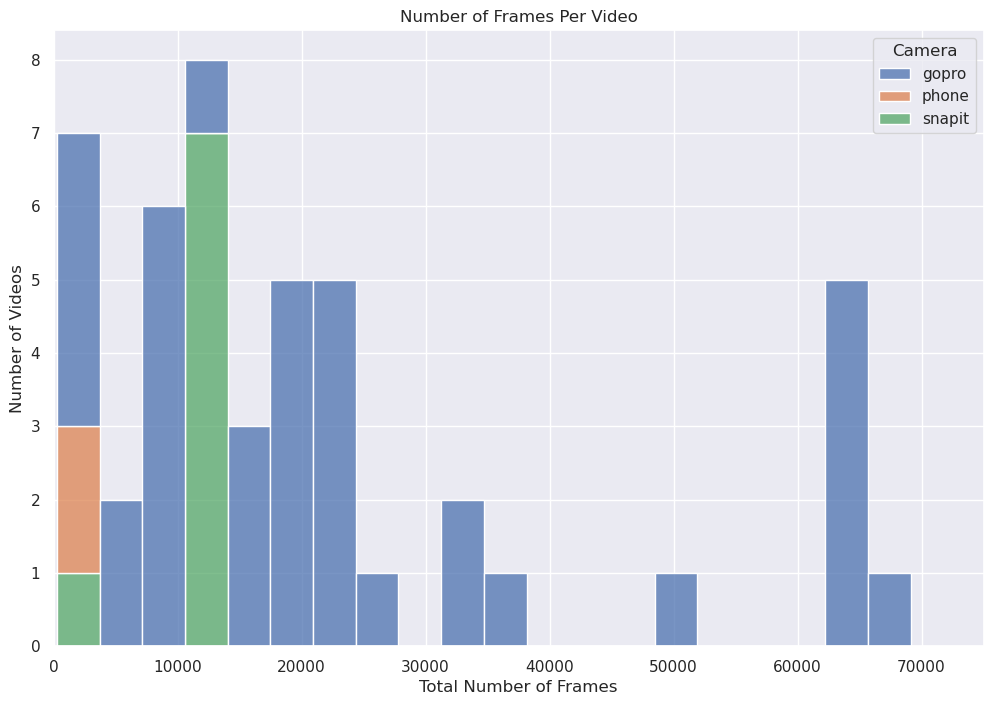

In [3]:
sns.histplot(data=videos_df, x="TotalNumFrames", hue="Camera", multiple="stack", bins=20)
plt.xlim((0, 75000))
plt.title("Number of Frames Per Video")
plt.xlabel("Total Number of Frames")
plt.ylabel("Number of Videos")
plt.show()

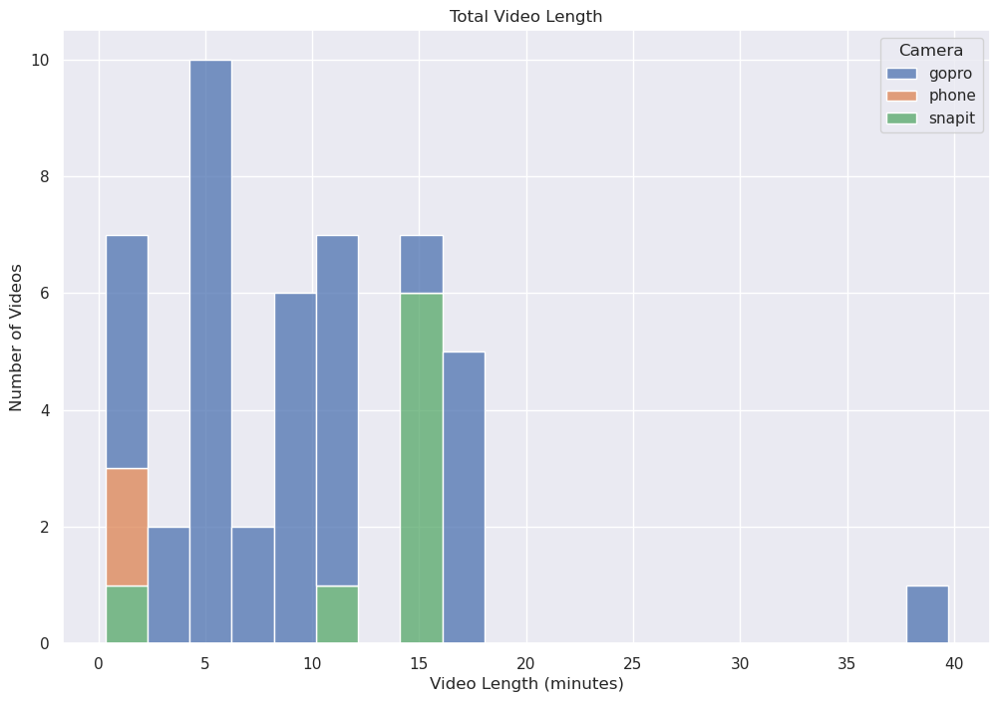

In [4]:
sns.histplot(data=videos_df, x="Length", hue="Camera", multiple="stack", bins=20)
plt.title("Total Video Length")
plt.xlabel("Video Length (minutes)")
plt.ylabel("Number of Videos")
plt.show()

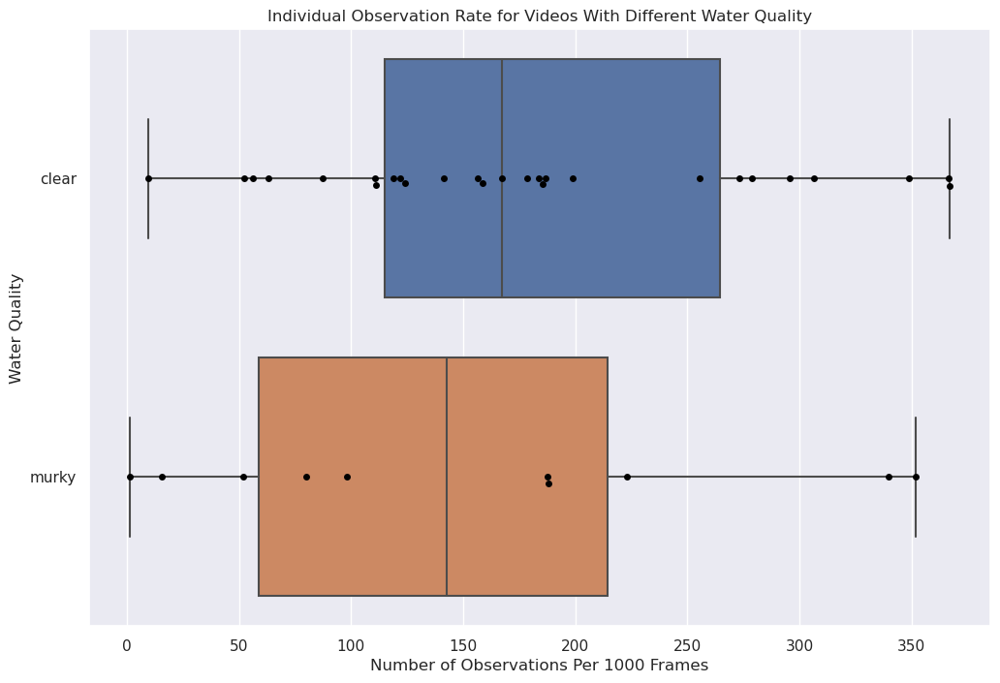

In [52]:
df = videos_df[videos_df["Camera"] == "gopro"]
sns.boxplot(data=df, x="ObservationRatePer1000", y="WaterQuality")
sns.swarmplot(data=df, x="ObservationRatePer1000", y="WaterQuality", color="black")
plt.title("Individual Observation Rate for Videos With Different Water Quality")
plt.xlabel("Number of Observations Per 1000 Frames")
plt.ylabel("Water Quality")
plt.show()

In [6]:
# sns.barplot(data=videos_df, x="Year", y="NumFramesWithIndividuals")
# plt.title("Distribution of Useable Frames Per Year")
# plt.xlabel("Year")
# plt.ylabel("Number of Useable Frames")
# plt.show()

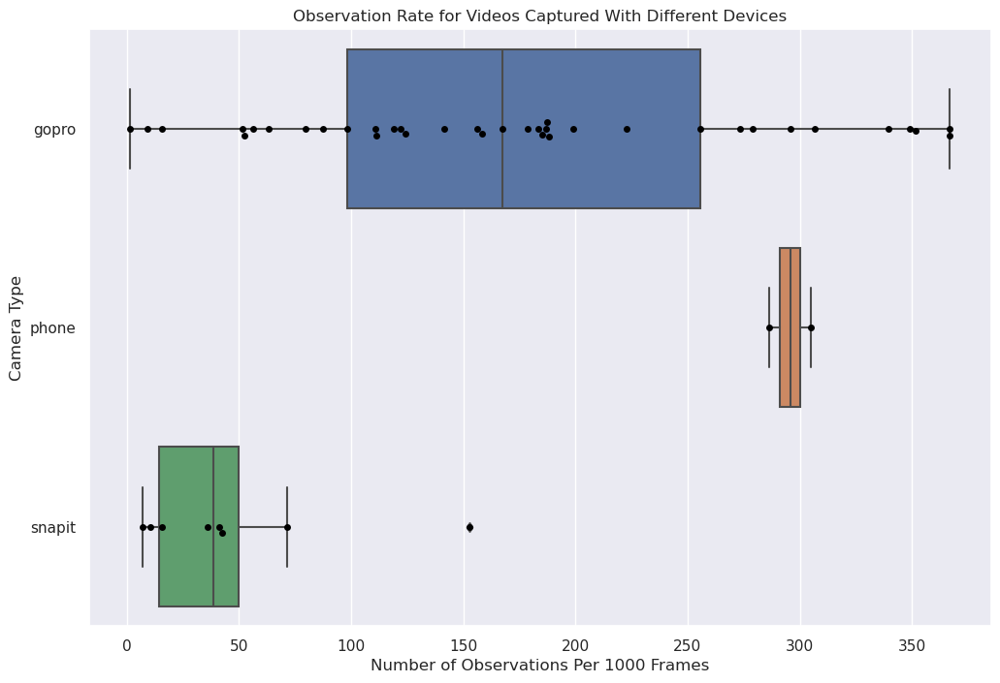

In [7]:
sns.boxplot(data=videos_df, x="ObservationRatePer1000", y="Camera")
sns.swarmplot(data=videos_df, x="ObservationRatePer1000", y="Camera", color="black")
plt.title("Observation Rate for Videos Captured With Different Devices")
plt.xlabel("Number of Observations Per 1000 Frames")
plt.ylabel("Camera Type")
plt.show()

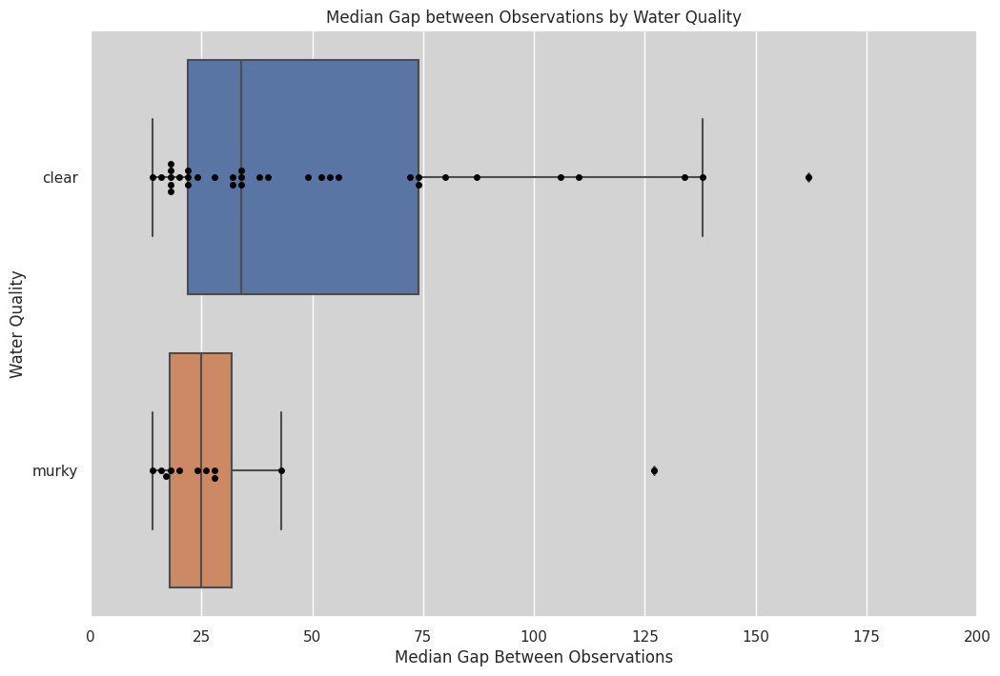

In [24]:
sns.boxplot(data=videos_df, x="MedianGap", y="WaterQuality")
sns.swarmplot(data=videos_df, x="MedianGap", y="WaterQuality", color="black")
plt.xlim((0, 200))
plt.title("Median Gap between Observations by Water Quality")
plt.xlabel("Median Gap Between Observations")
plt.ylabel("Water Quality")
plt.show()

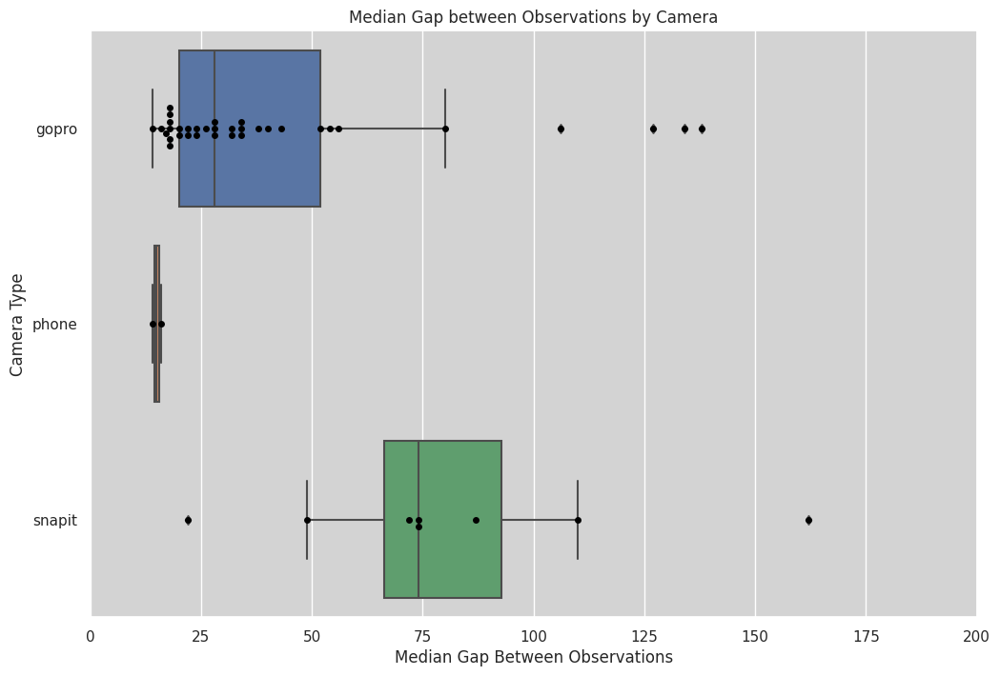

In [26]:
sns.boxplot(data=videos_df, x="MedianGap", y="Camera")
sns.swarmplot(data=videos_df, x="MedianGap", y="Camera", color="black")
plt.xlim((0, 200))
plt.title("Median Gap between Observations by Camera")
plt.xlabel("Median Gap Between Observations")
plt.ylabel("Camera Type")
plt.show()

In [10]:
observations_df.head()

,ObservationPath,FirstFrameNumber,IndividualID,WaterQuality,Brightness,Camera,ObservationAreaPx,NumSpots,VideoName
0,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,926,0_2,clear,bright,gopro,386757,0,2021-09-03_10-40-53_B5
1,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,928,0_2,clear,bright,gopro,358092,0,2021-09-03_10-40-53_B5
2,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,930,0_2,clear,bright,gopro,405040,0,2021-09-03_10-40-53_B5
3,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,930,0_3,clear,bright,gopro,899391,0,2021-09-03_10-40-53_B5
4,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,932,0_3,clear,bright,gopro,968841,3,2021-09-03_10-40-53_B5


In [11]:
observations_df.sort_values(["NumSpots"], ascending=False)

,ObservationPath,FirstFrameNumber,IndividualID,WaterQuality,Brightness,Camera,ObservationAreaPx,NumSpots,VideoName
29166,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,11880,11_363,clear,bright,gopro,4851444,177,2021-09-03_10-57-20_B5
38322,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,6456,6_222,clear,bright,gopro,3521760,176,2021-09-03_10-57-20_B5
38325,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,6462,6_222,clear,bright,gopro,3493581,175,2021-09-03_10-57-20_B5
29173,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,11886,11_363,clear,bright,gopro,4741686,173,2021-09-03_10-57-20_B5
38326,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,6464,6_222,clear,bright,gopro,3598560,173,2021-09-03_10-57-20_B5
...,...,...,...,...,...,...,...,...,...
90510,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,12818,12_239,clear,bright,gopro,106655,0,G0019499
90509,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,12816,12_262,clear,bright,gopro,417968,0,G0019499
90508,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,12816,12_239,clear,bright,gopro,94428,0,G0019499
90507,/workspace/hrrsxb/AIP/Morphometrics/workflows/...,12814,12_262,clear,bright,gopro,378180,0,G0019499


In [12]:
obs_df_aggregated = observations_df.sort_values(["NumSpots"], ascending=False).groupby(["VideoName", "IndividualID"]).agg({
    "ObservationPath": "first",
    "FirstFrameNumber": "first",
    "WaterQuality": "first",
    "Brightness": "first",
    "Camera": "first",
    "ObservationAreaPx": np.max,
    "NumSpots": np.max,
})

obs_df_aggregated

ObservationPath  \
VideoName              IndividualID                                                      
2021-09-03_10-40-53_B5 0_2           /workspace/hrrsxb/AIP/Morphometrics/workflows/...   
                       0_3           /workspace/hrrsxb/AIP/Morphometrics/workflows/...   
                       0_4           /workspace/hrrsxb/AIP/Morphometrics/workflows/...   
                       0_6           /workspace/hrrsxb/AIP/Morphometrics/workflows/...   
                       0_7           /workspace/hrrsxb/AIP/Morphometrics/workflows/...   
...                                                                                ...   
SHD_8f03-1659831300    9_15113       /workspace/hrrsxb/AIP/Morphometrics/workflows/...   
                       9_15176       /workspace/hrrsxb/AIP/Morphometrics/workflows/...   
                       9_15685       /workspace/hrrsxb/AIP/Morphometrics/workflows/...   
                       9_15846       /workspace/hrrsxb/AIP/Morphometrics/workflows/...   
                       9_15888       /workspace/hrrsxb/AIP/Morphometrics/workflows/...   

                                     FirstFrameNumber WaterQuality Brightness  \
VideoName              IndividualID                                             
2021-09-03_10-40-53_B5 0_2                        944        clear     bright   
                       0_3                        936        clear     bright   
                       0_4                        994        clear     bright   
                       0_6                        980        clear     bright   
                       0_7                        988        clear     bright   
...                                               ...          ...        ...   
SHD_8f03-1659831300    9_15113                   9420        clear        dim   
                       9_15176                   9474        clear        dim   
                       9_15685                   9786        clear        dim   
                       9_15846                   9914        clear        dim   
                       9_15888                   9910        clear        dim   

                                     Camera  ObservationAreaPx  NumSpots  
VideoName              IndividualID                                       
2021-09-03_10-40-53_B5 0_2            gopro             427810         1  
                       0_3            gopro            1018080         7  
                       0_4            gopro             745416         5  
                       0_6            gopro             332505         0  
                       0_7            gopro             341583         0  
...                                     ...                ...       ...  
SHD_8f03-1659831300    9_15113       snapit             166495         0  
                       9_15176       snapit             234360         3  
                       9_15685       snapit             216315         0  
                       9_15846       snapit             604893         3  
                       9_15888       snapit             300655         0  

[16681 rows x 7 columns]

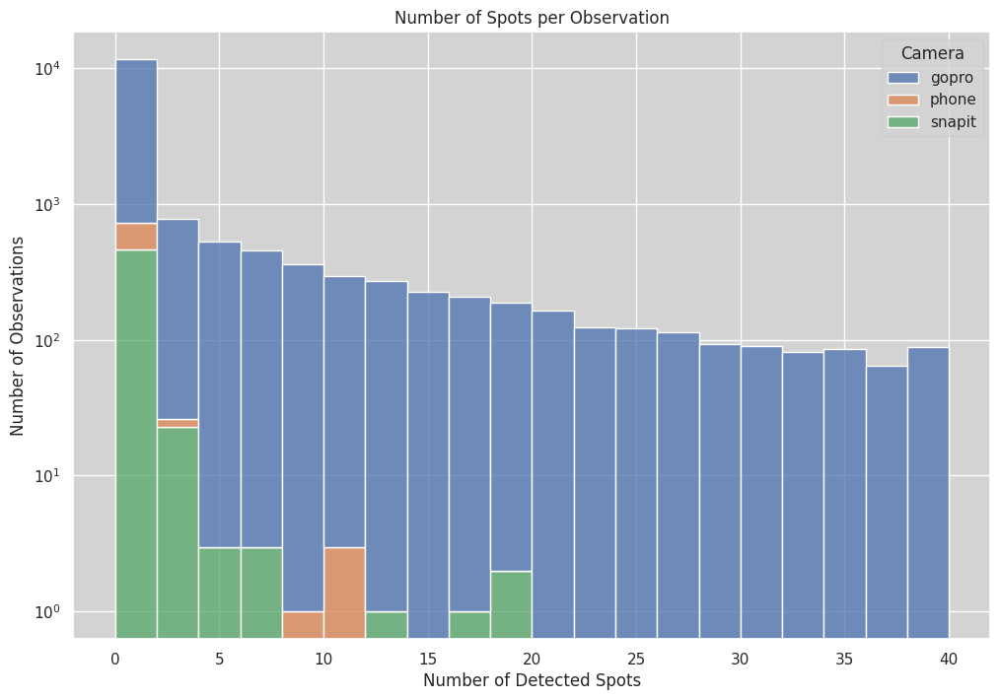

In [28]:
sns.histplot(data=obs_df_aggregated, x="NumSpots", hue="Camera", bins=20, binrange=[0, 40], log_scale=[False, True], multiple="stack")
plt.title('Number of Spots per Observation')
plt.xlabel("Number of Detected Spots")
plt.ylabel("Number of Observations")
plt.show()

In [34]:
num_frames = videos_df["TotalNumFrames"].sum()
num_usable_obs = len(obs_df_aggregated[obs_df_aggregated["NumSpots"] >= 15])
num_good_obs = len(obs_df_aggregated[obs_df_aggregated["NumSpots"] >= 20])
print(f"{num_frames} total frames")
print(f"{len(observations_df)} total observations were found, with {len(obs_df_aggregated)} unique observations")
print(f"{num_usable_obs} observations had 15 or more spots ({num_usable_obs/num_frames:0.2%} of total frames considered)")
print(f"{num_good_obs} observations had 20 or more spots ({num_good_obs/num_frames:0.2%} of total frames considered)")

993629 total frames
186800 total observations were found, with 16681 unique observations
2286 observations had 15 or more spots (0.23% of total frames considered)
1785 observations had 20 or more spots (0.18% of total frames considered)


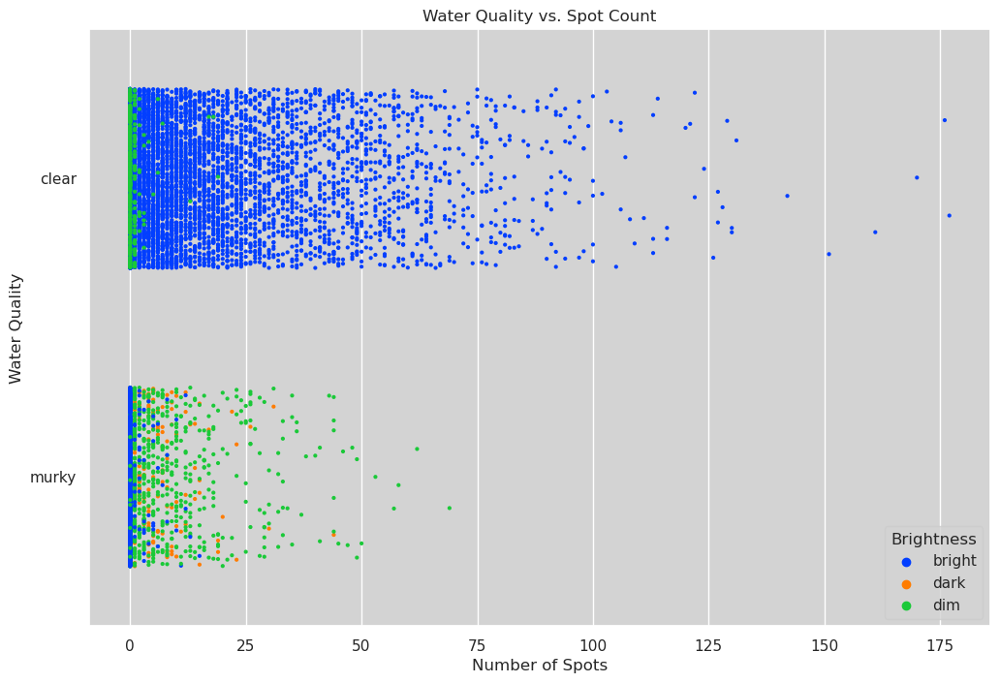

In [43]:
sns.stripplot(
    data=obs_df_aggregated, 
    x="NumSpots", 
    y="WaterQuality", 
    hue='Brightness', 
    size=3, 
    jitter=0.3, 
    palette='bright'
)

plt.title('Water Quality vs. Spot Count')
plt.xlabel("Number of Spots")
plt.ylabel("Water Quality")
plt.show()

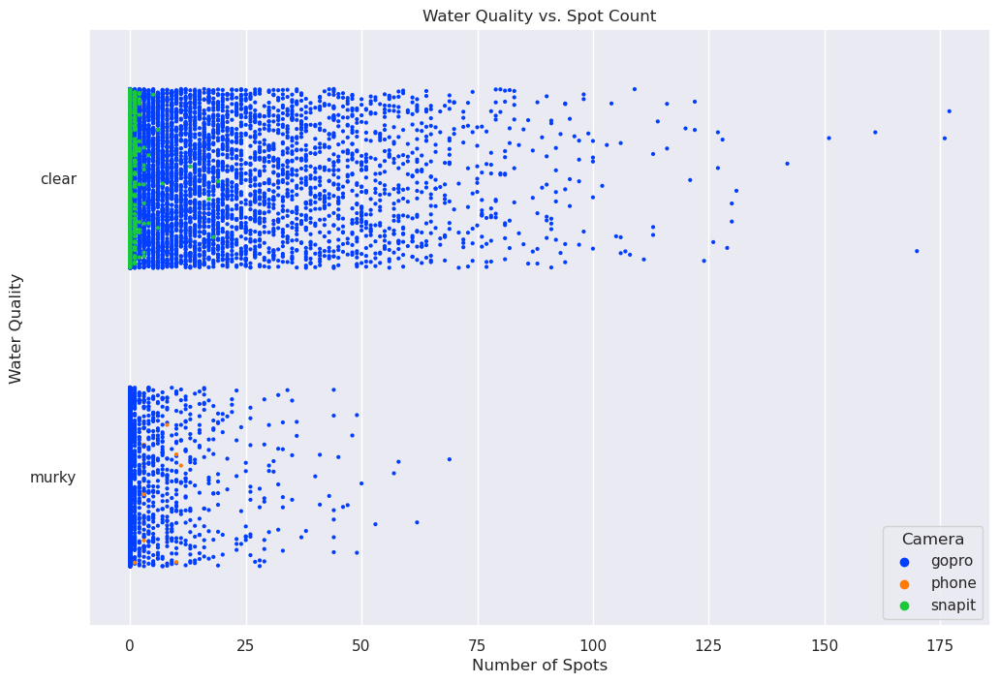

In [48]:
sns.stripplot(
    data=obs_df_aggregated, 
    x="NumSpots", 
    y="WaterQuality", 
    hue="Camera", 
    size=3, 
    jitter=0.3, 
    palette='bright'
)

plt.title('Water Quality vs. Spot Count')
plt.xlabel("Number of Spots")
plt.ylabel("Water Quality")
plt.show()

In [47]:
output_base = Path("output/")
shutil.rmtree(output_base)

groups = obs_df_aggregated.sort_values(["NumSpots", "ObservationAreaPx"], ascending=False).groupby(["WaterQuality", "Brightness", "Camera"])
for (water_quality, brightness, camera), df in groups:
    output_dir = output_base / f"{water_quality}-{brightness}-{camera}"
    
    for index, row in df.head(20).iterrows():
        image_path = Path(row["ObservationPath"]).with_suffix("")
        output_path = output_dir / "best" / image_path.name
        output_path.parent.mkdir(parents=True, exist_ok=True)
        shutil.copyfile(image_path, output_path)

    for index, row in df.sample(20).iterrows():
        image_path = Path(row["ObservationPath"]).with_suffix("")
        output_path = output_dir / "random" / image_path.name
        output_path.parent.mkdir(parents=True, exist_ok=True)
        shutil.copyfile(image_path, output_path)

clear bright gopro
Best images:


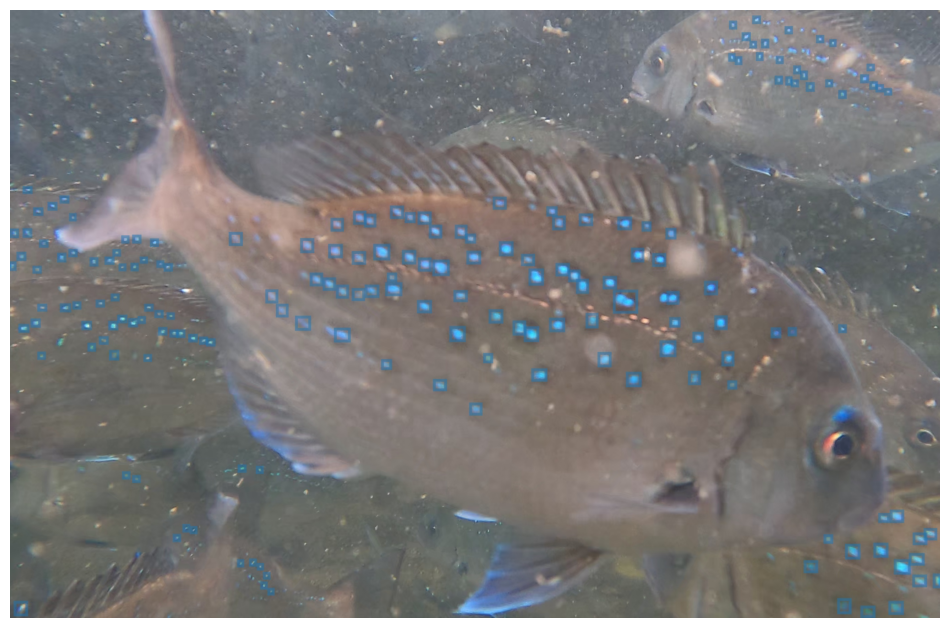

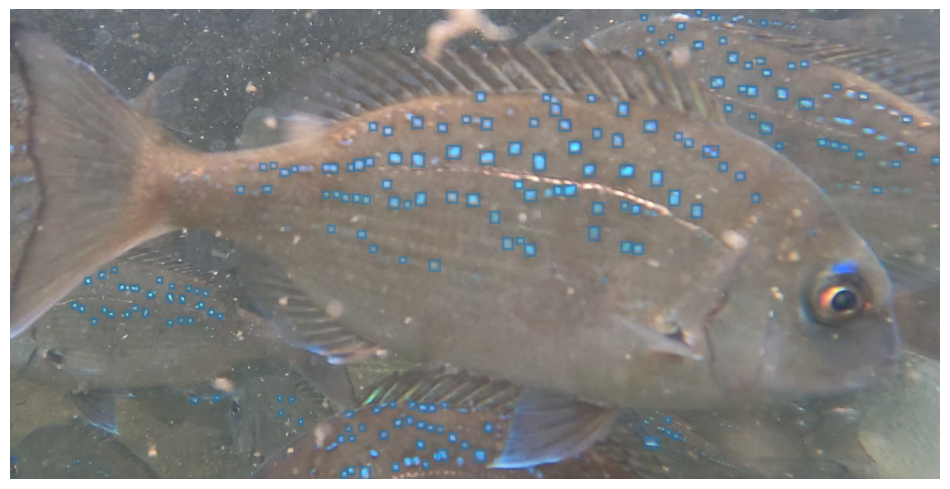

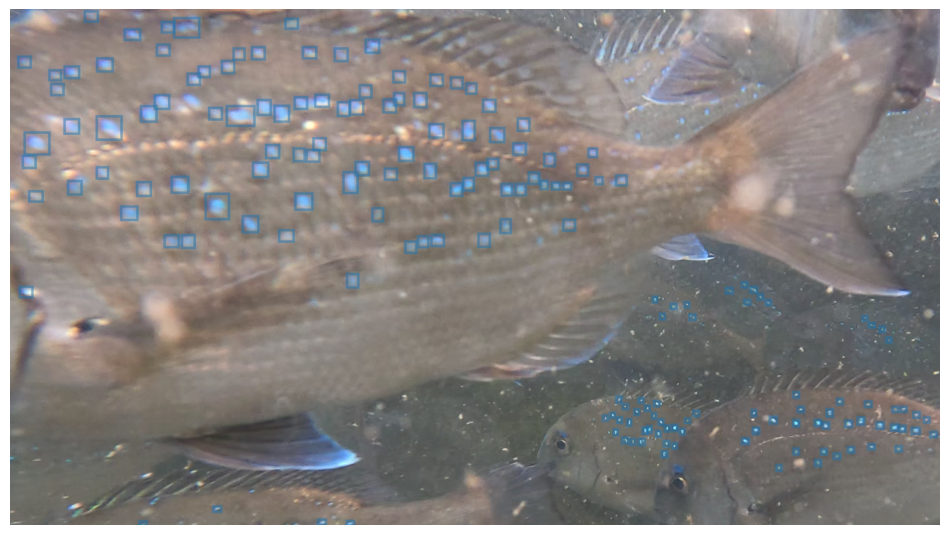

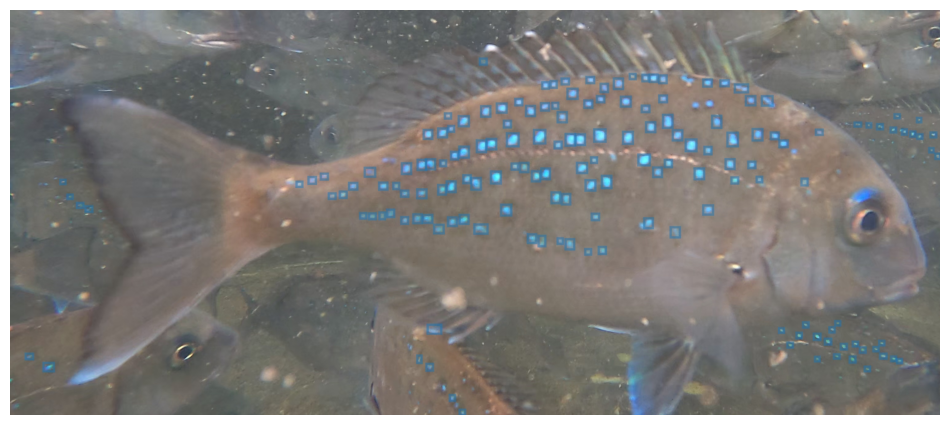

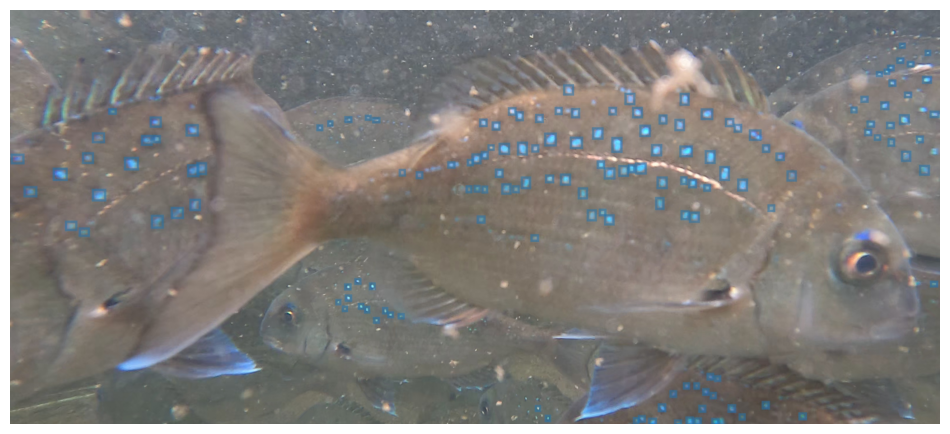

Random images:


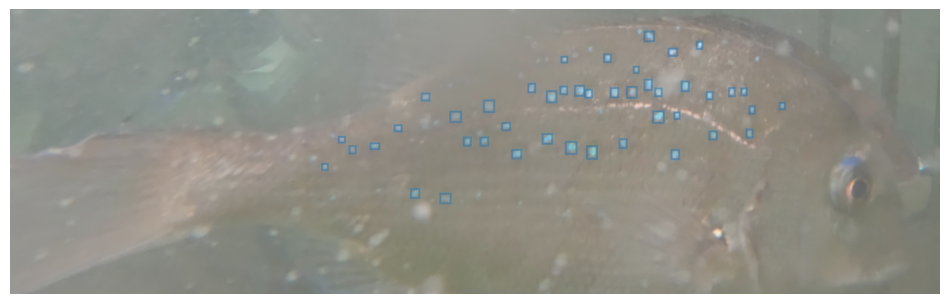

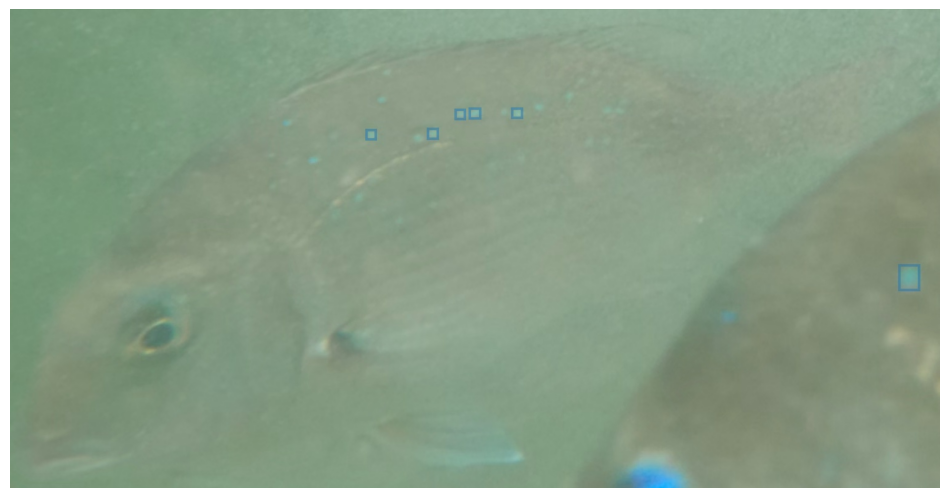

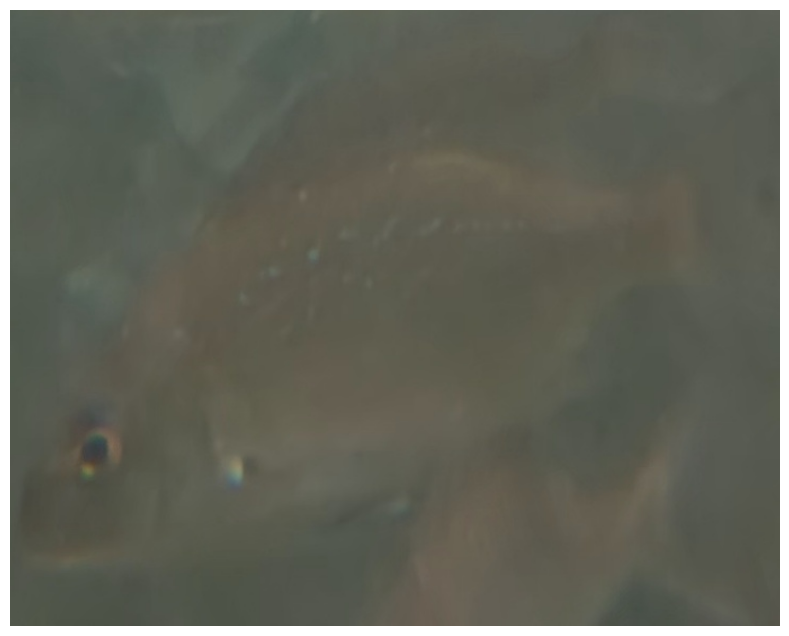

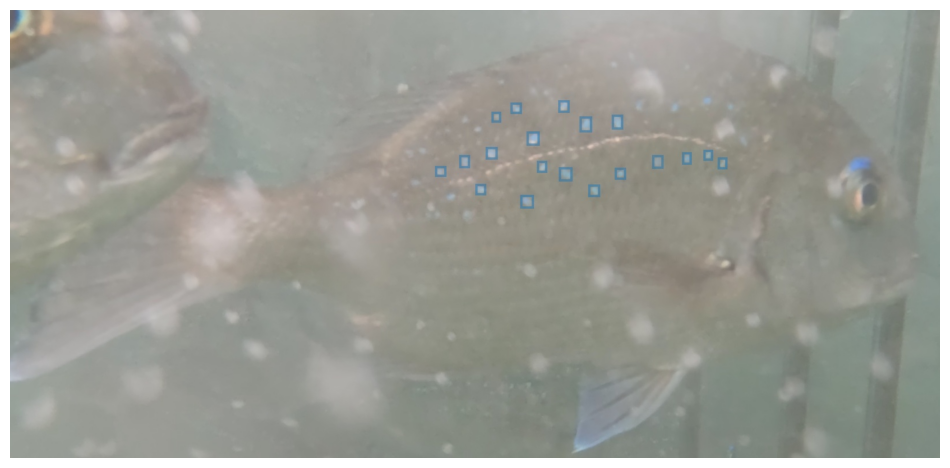

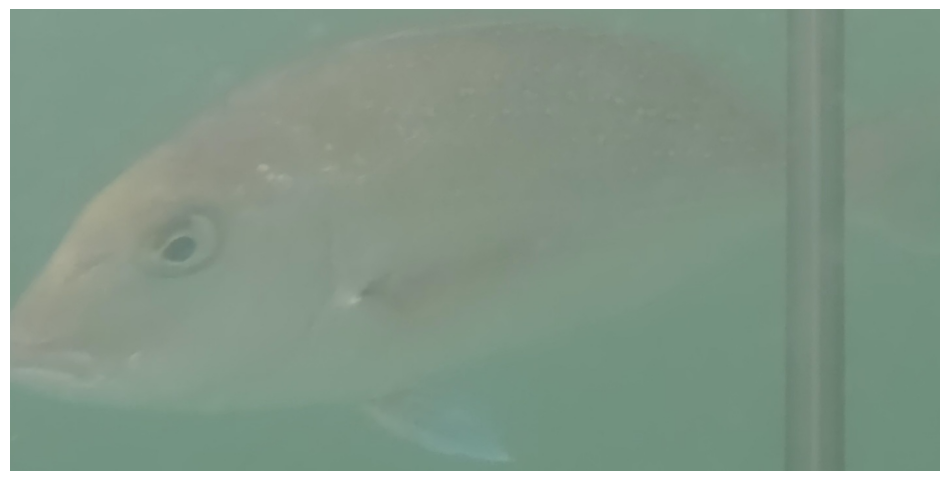

clear bright snapit
Best images:


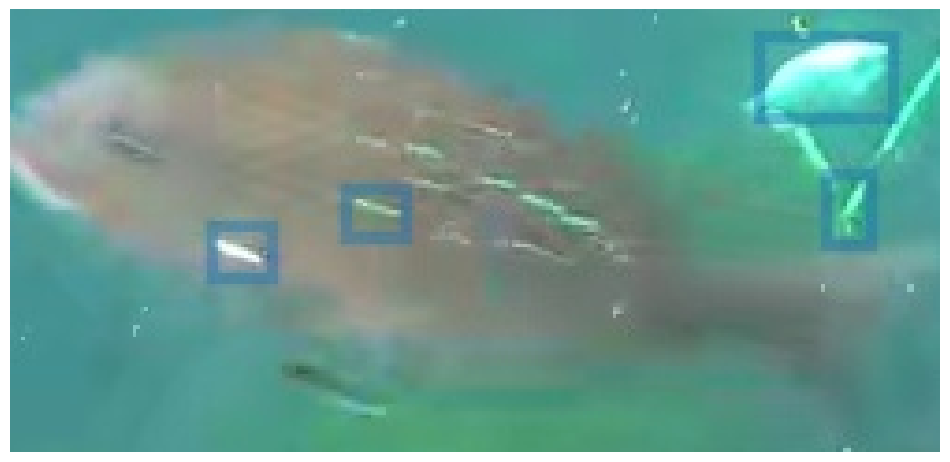

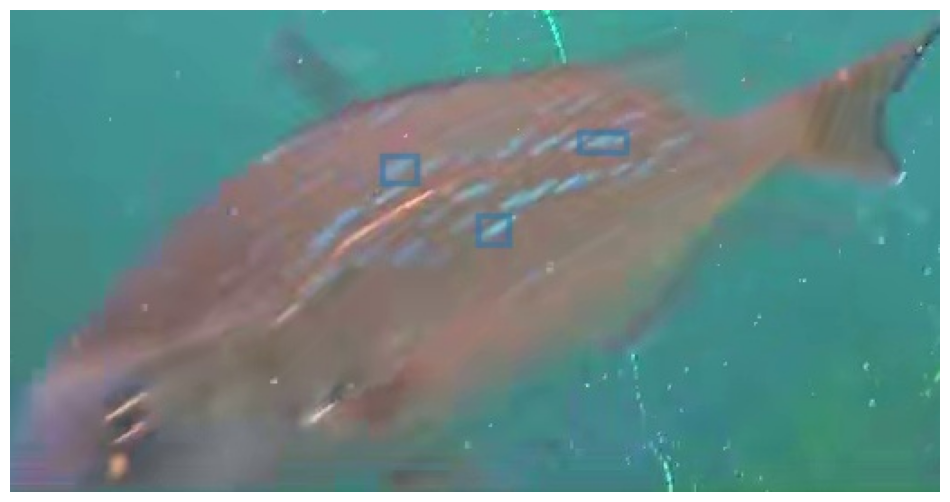

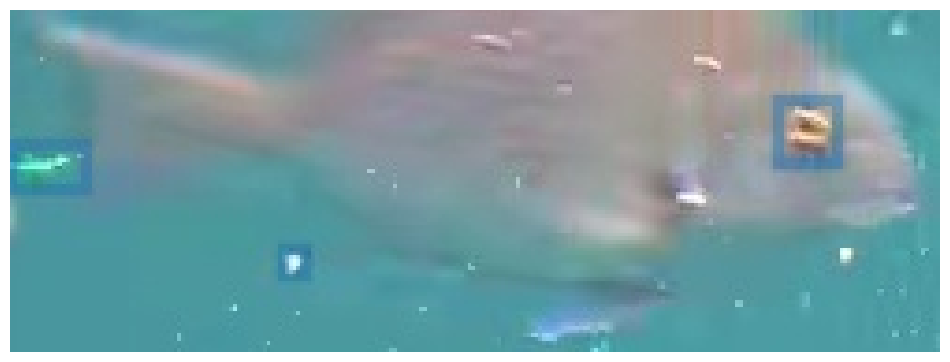

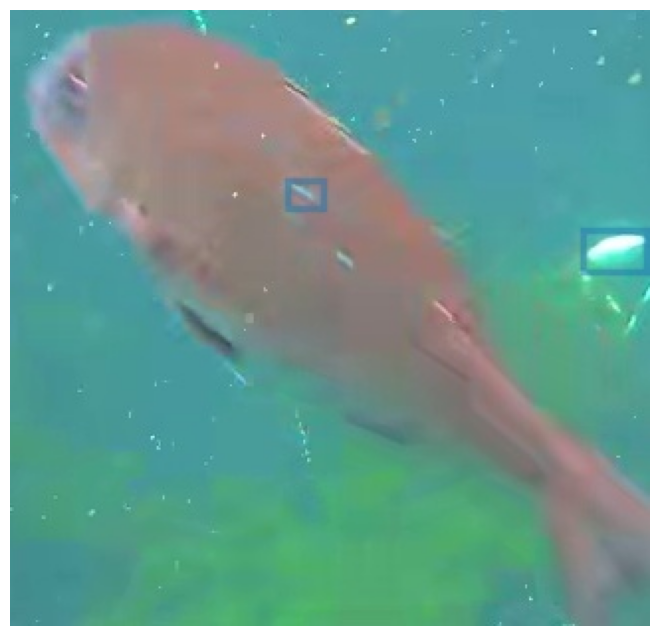

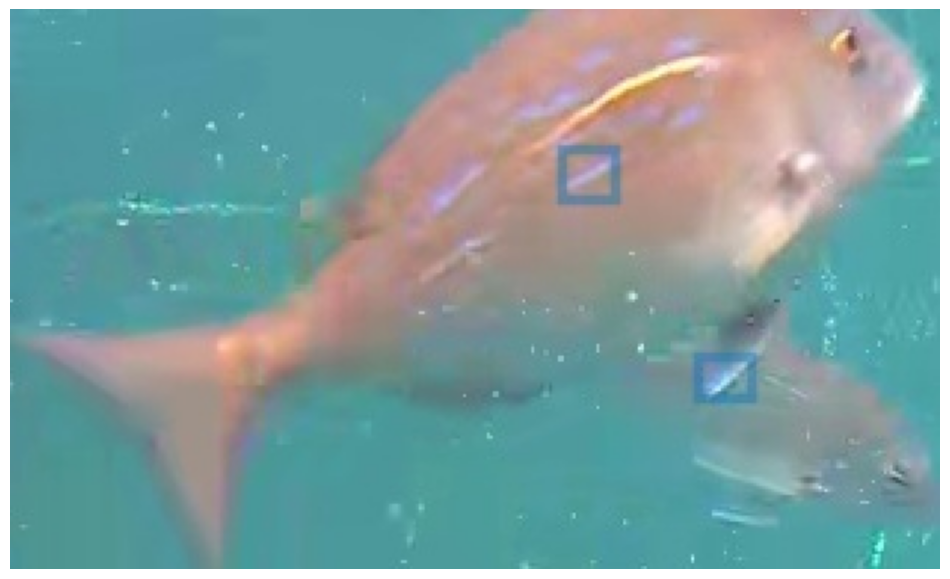

Random images:


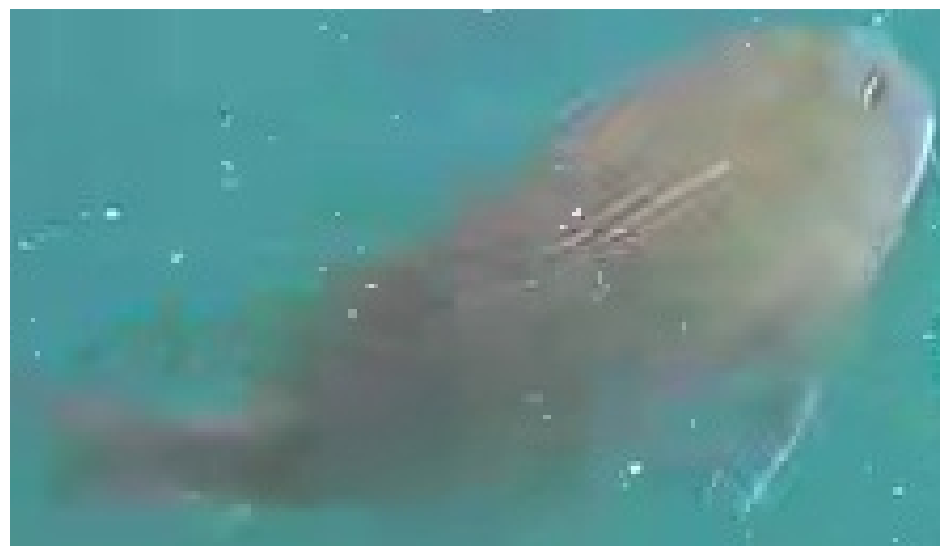

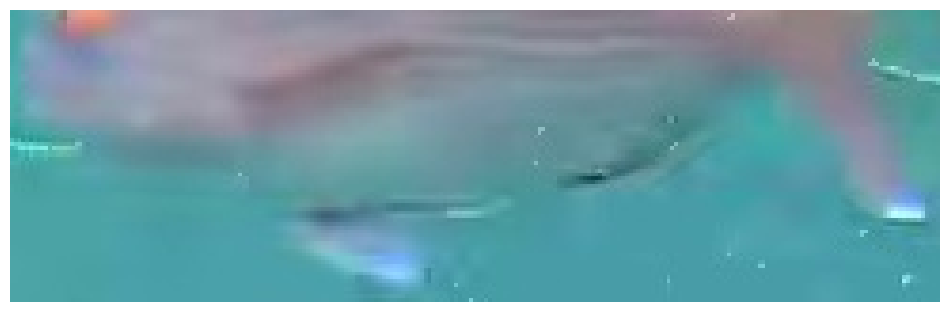

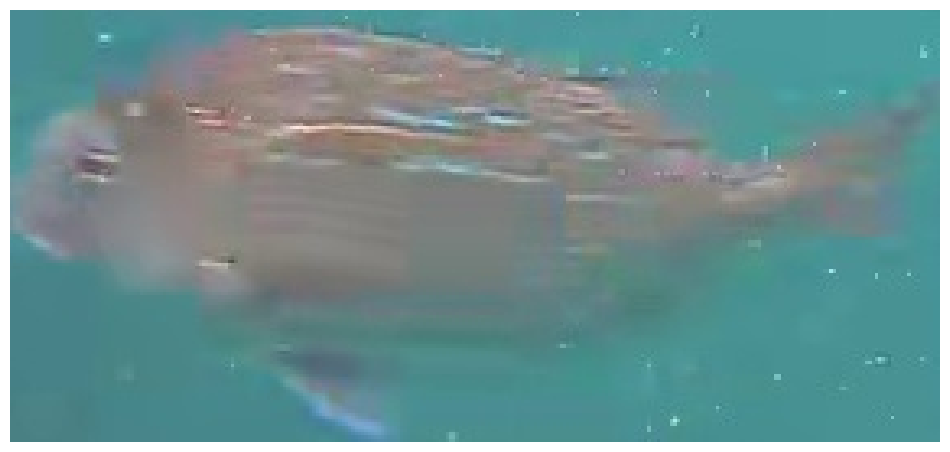

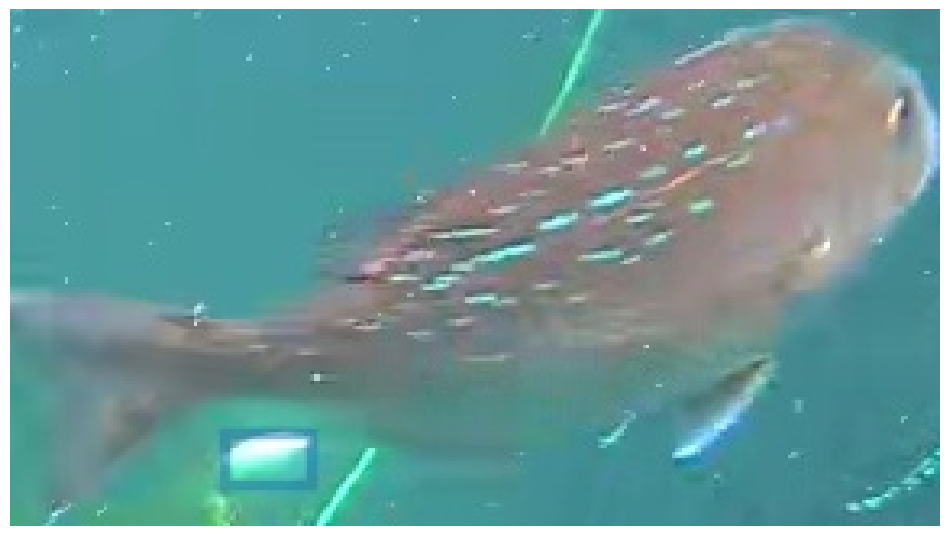

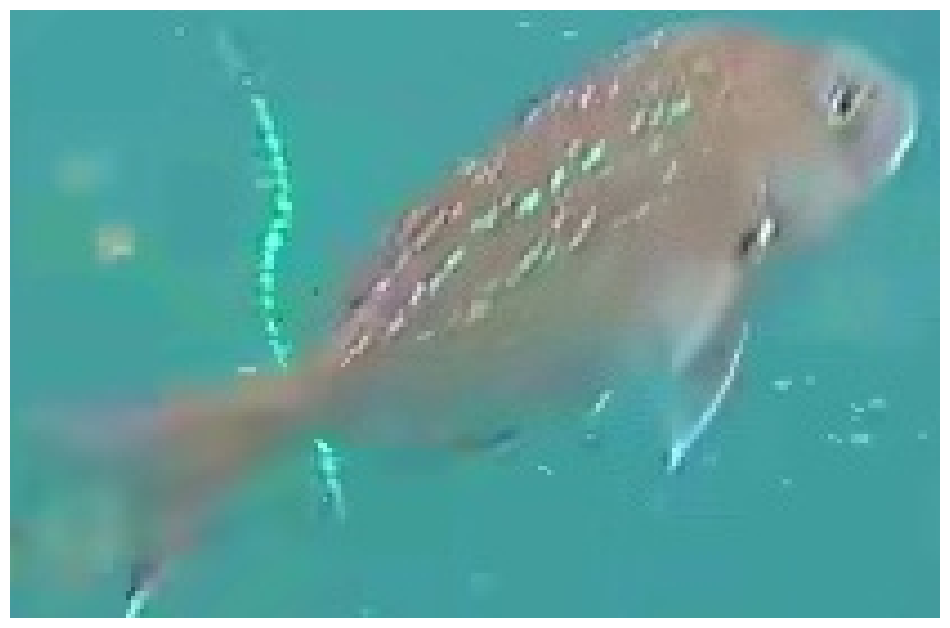

clear dim snapit
Best images:


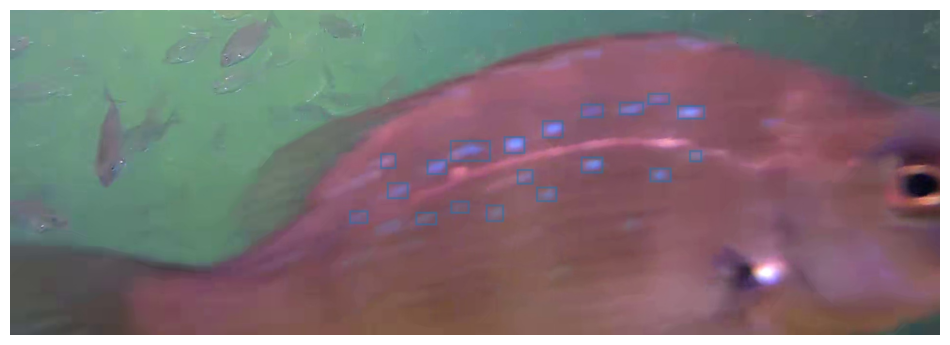

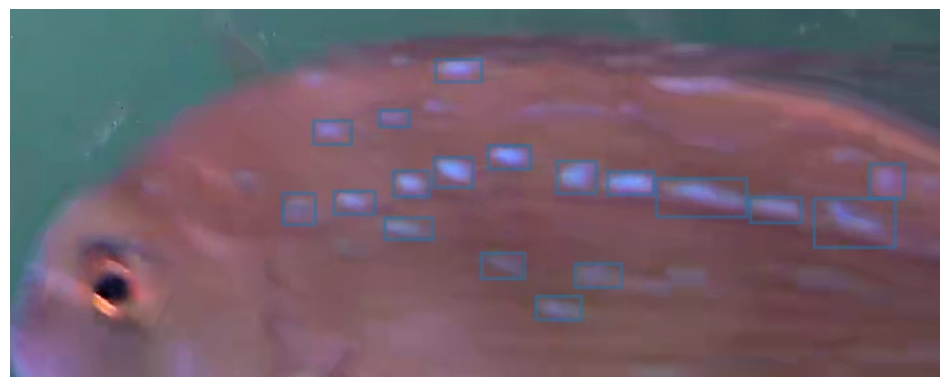

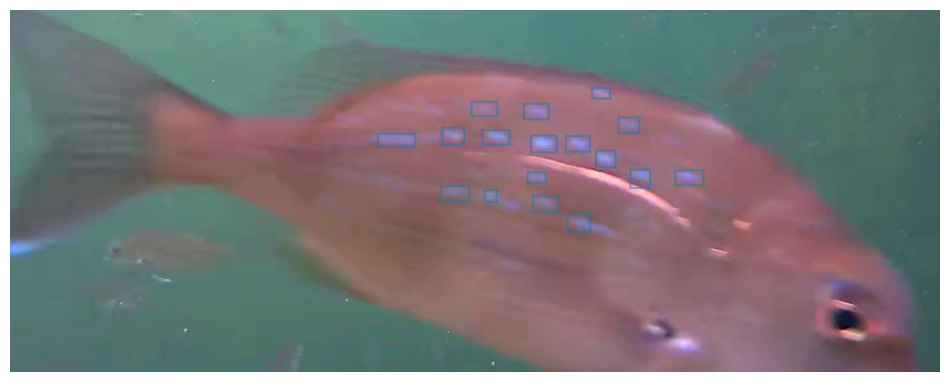

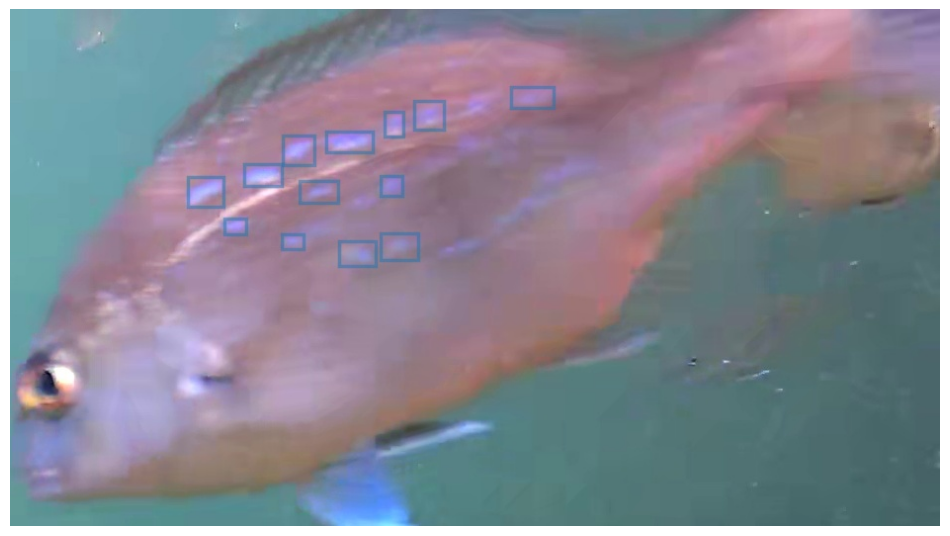

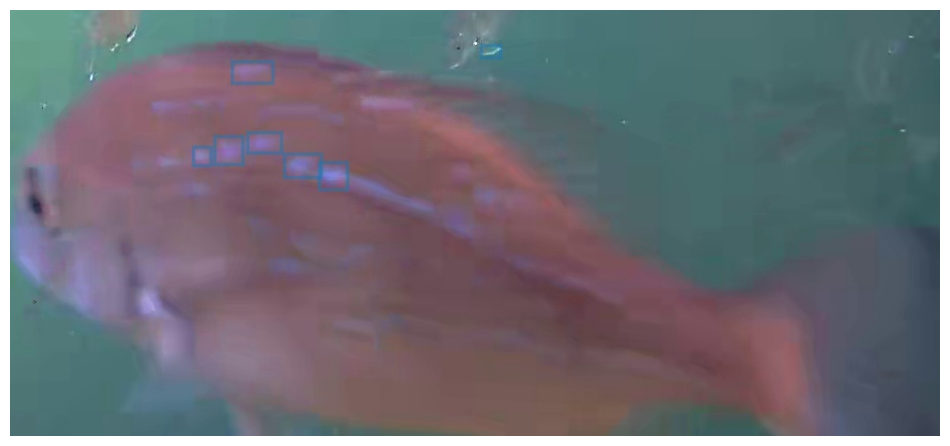

Random images:


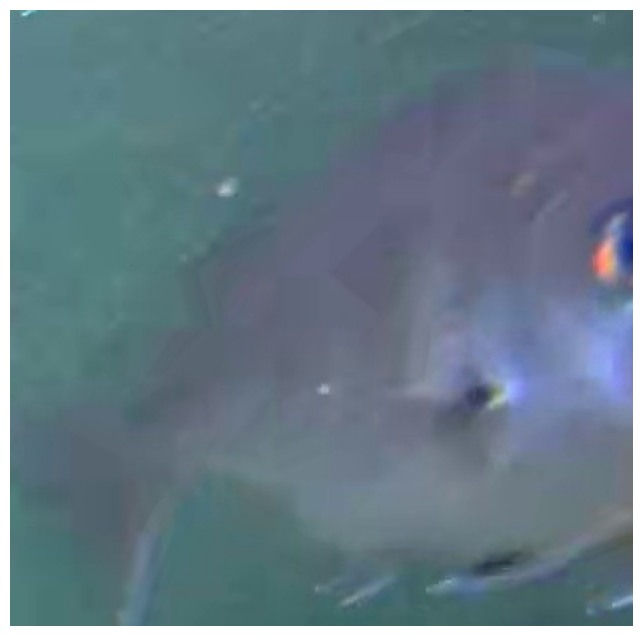

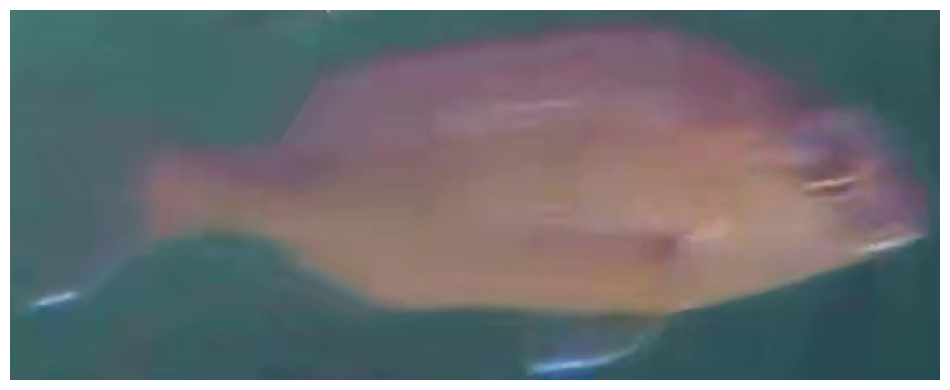

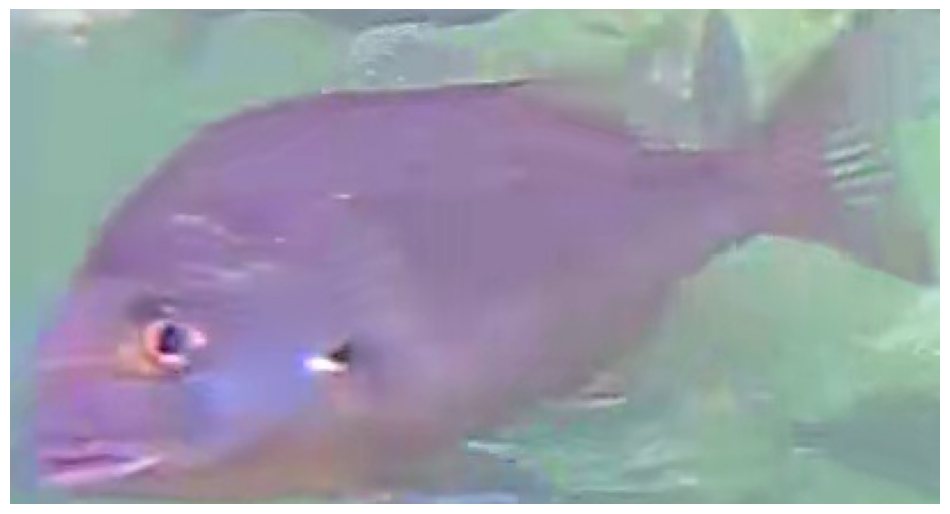

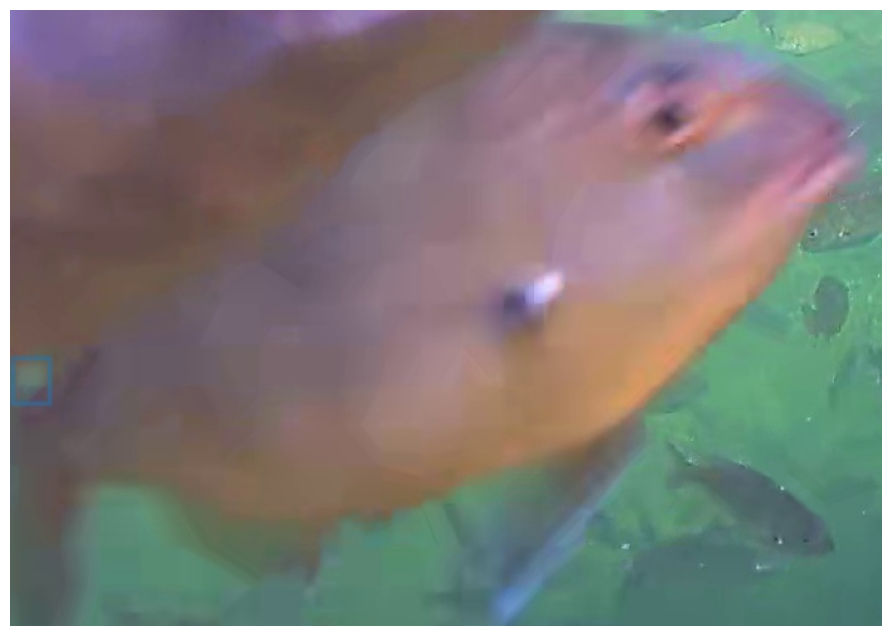

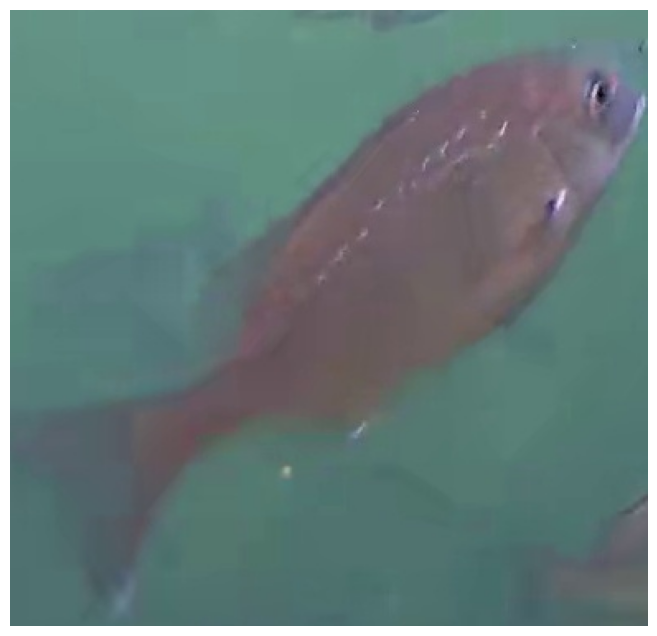

murky bright gopro
Best images:


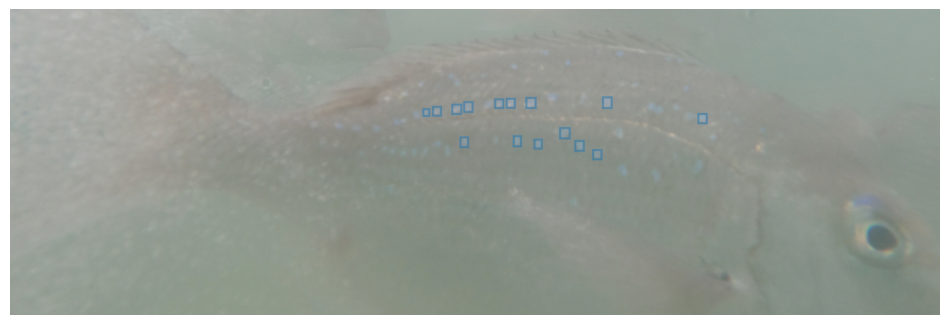

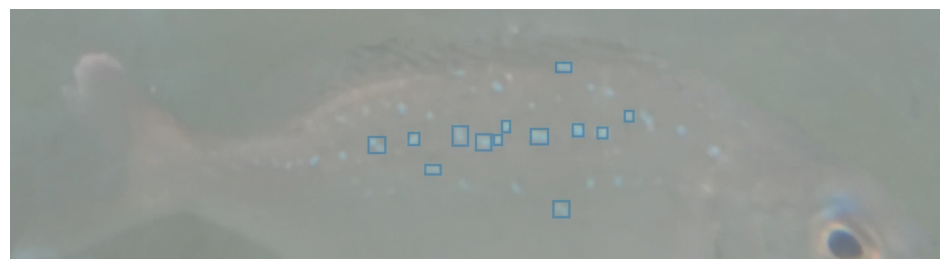

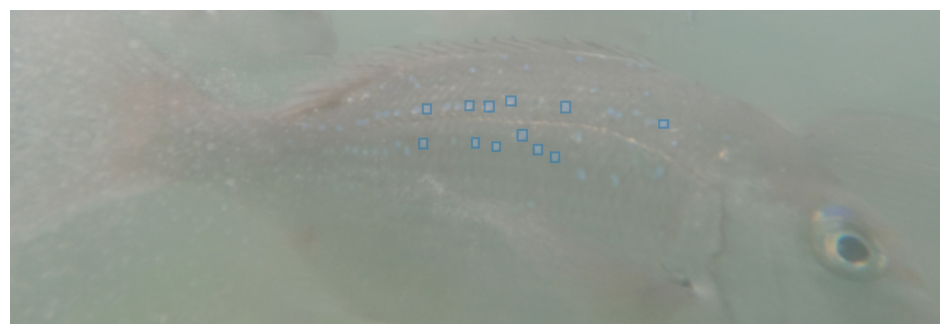

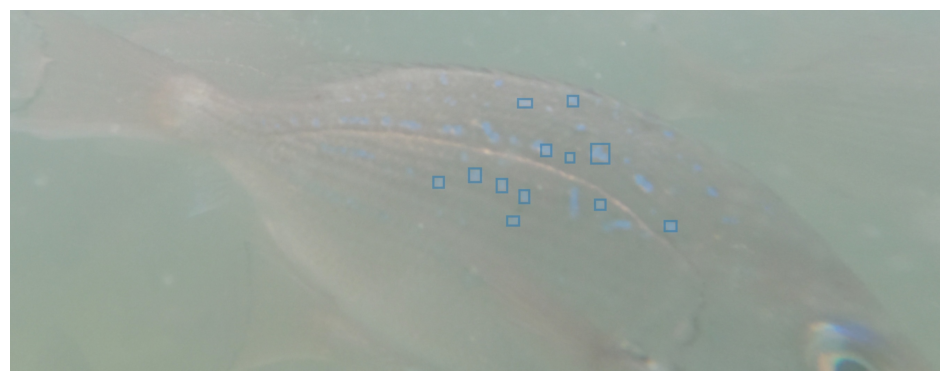

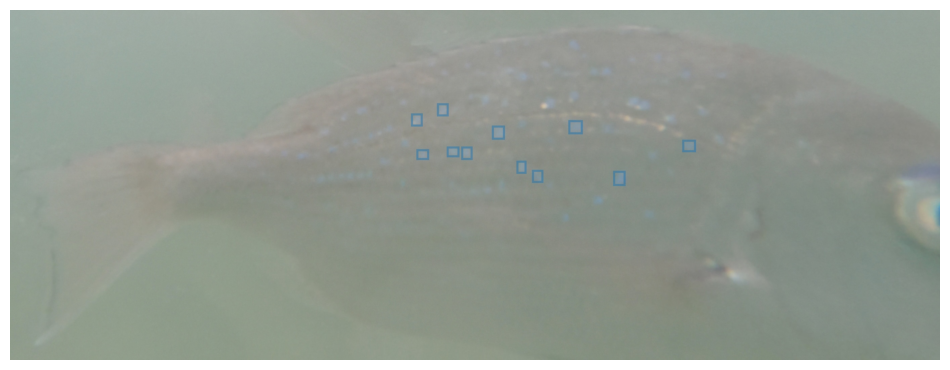

Random images:


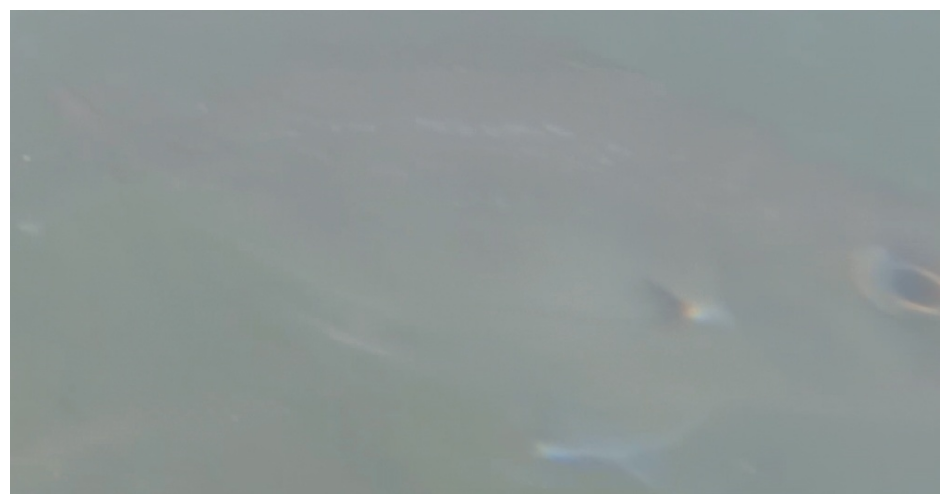

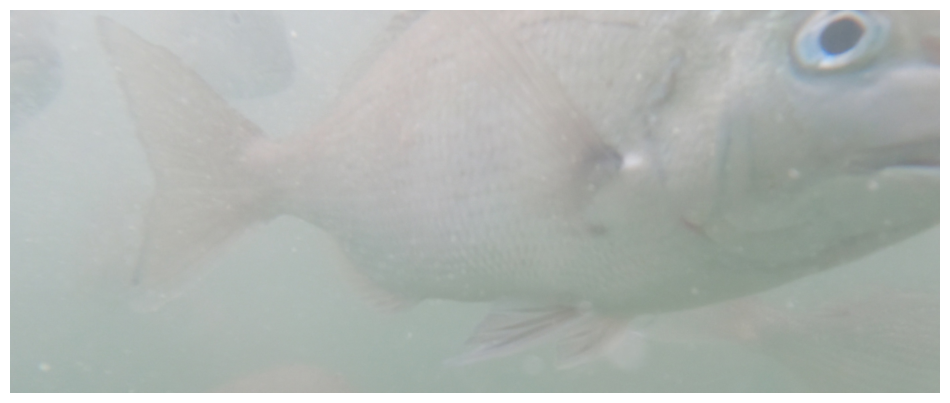

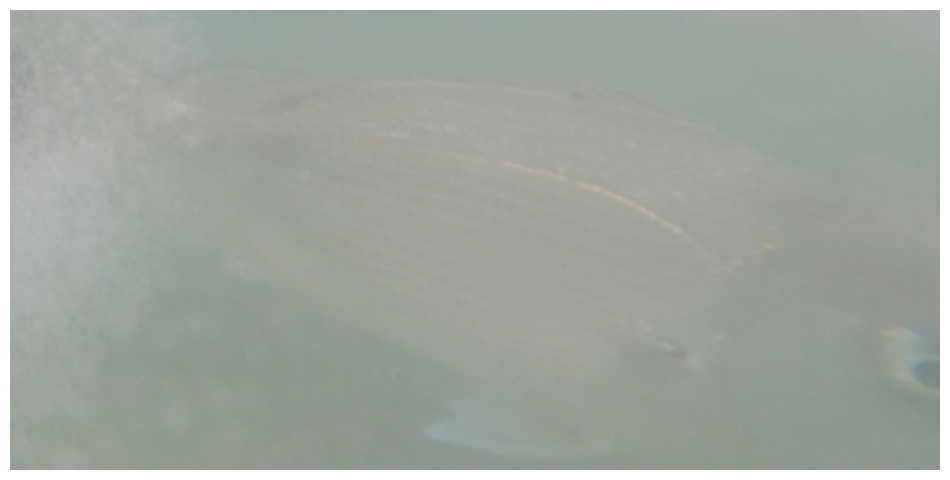

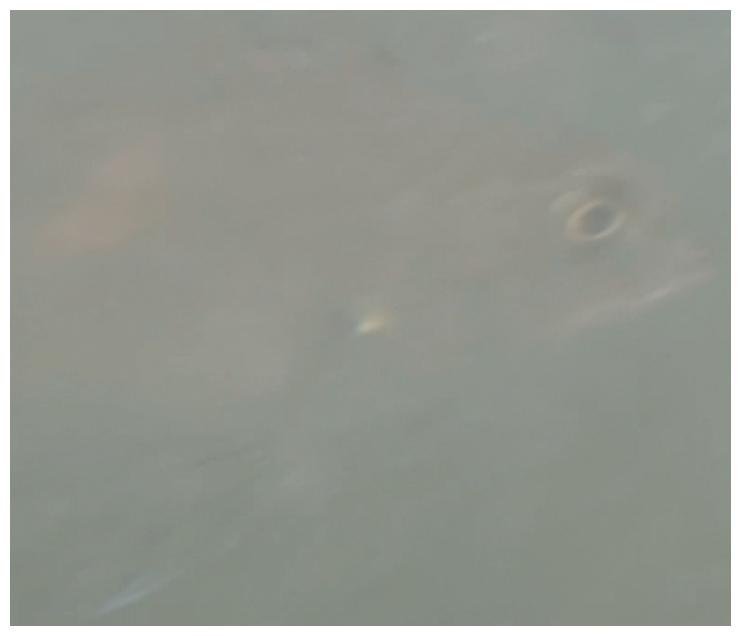

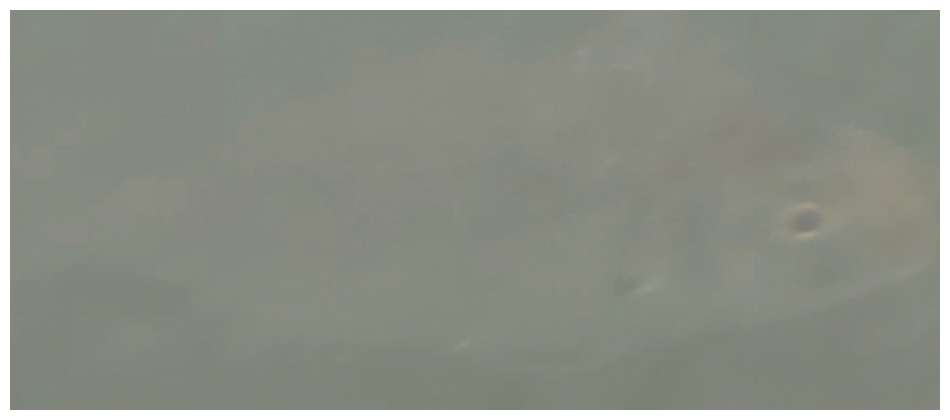

murky dark gopro
Best images:


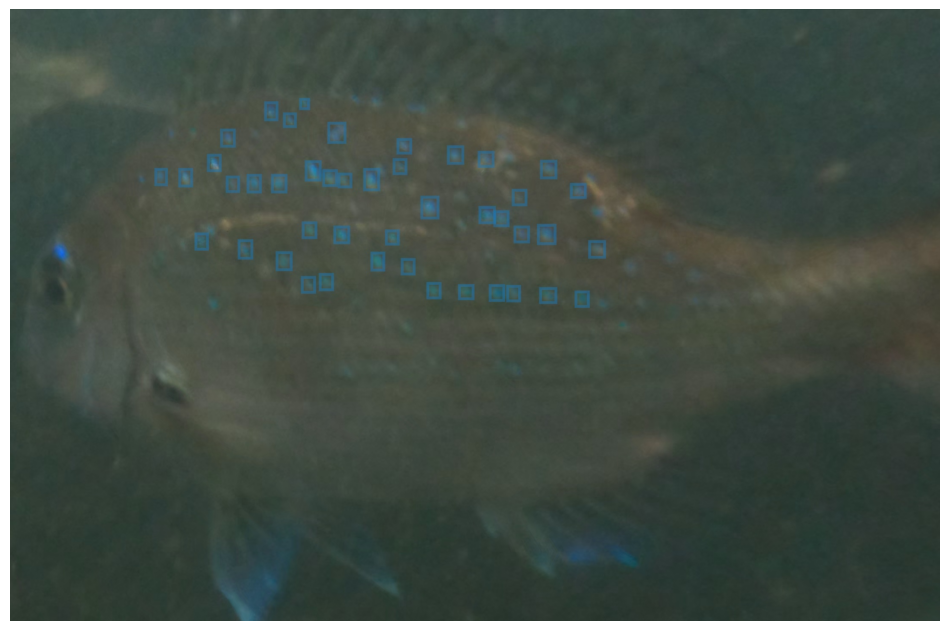

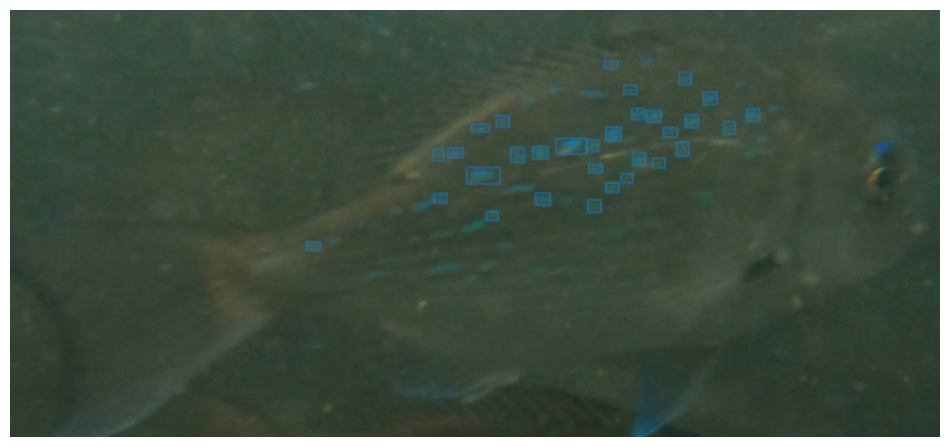

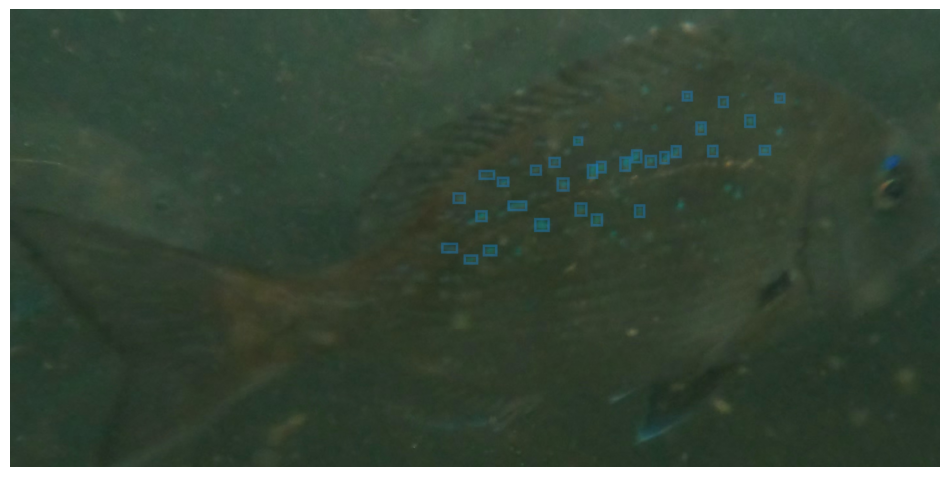

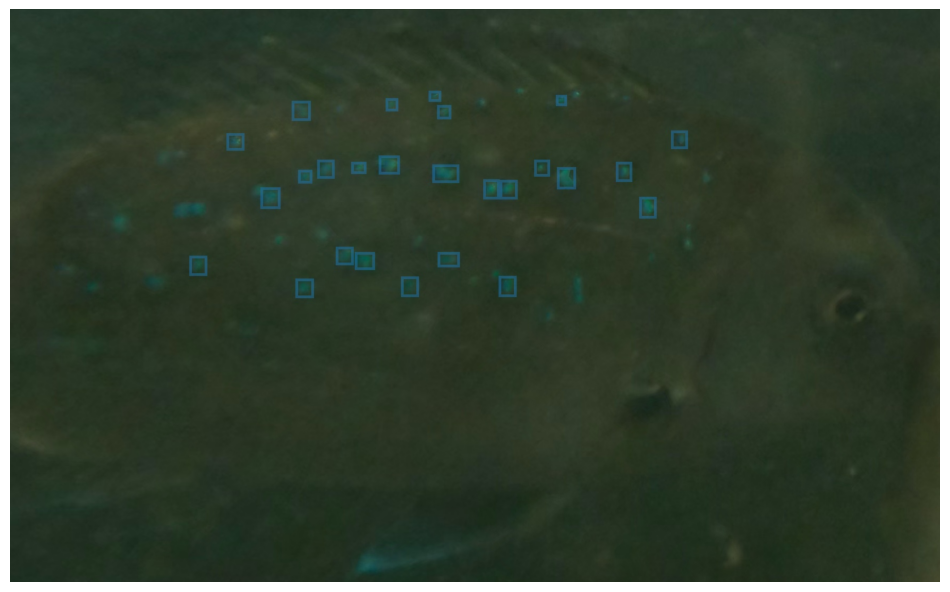

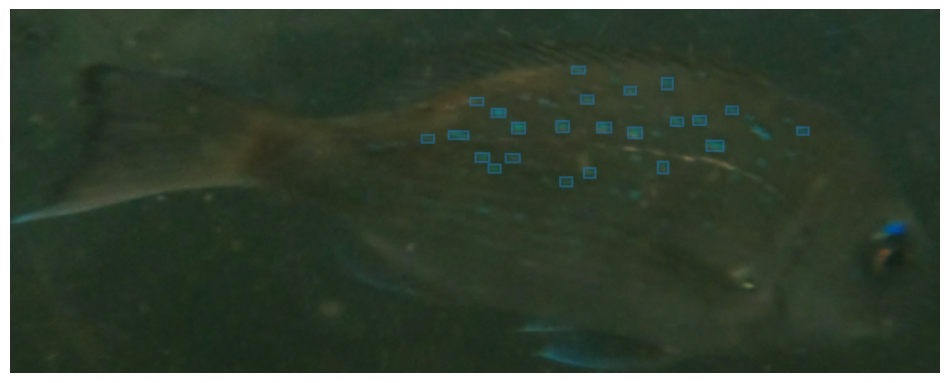

Random images:


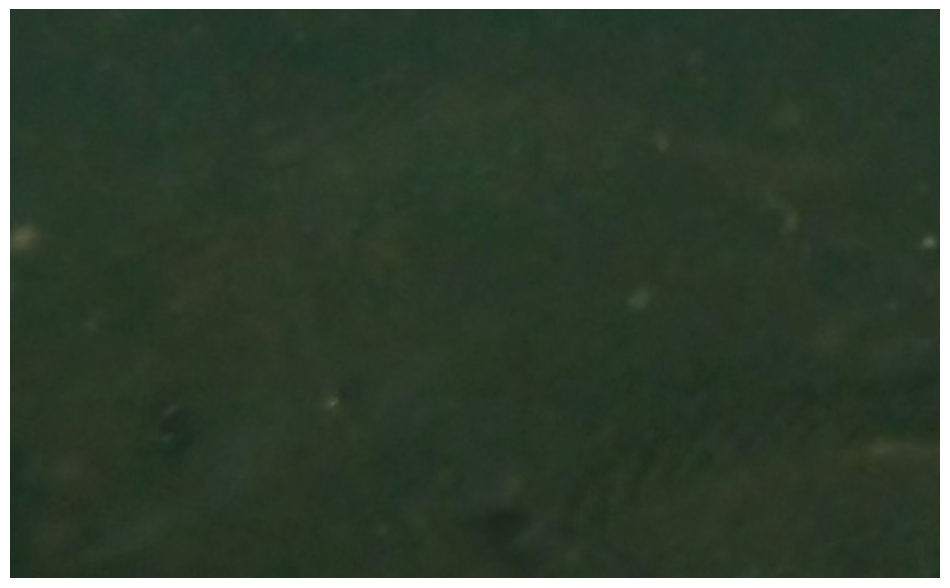

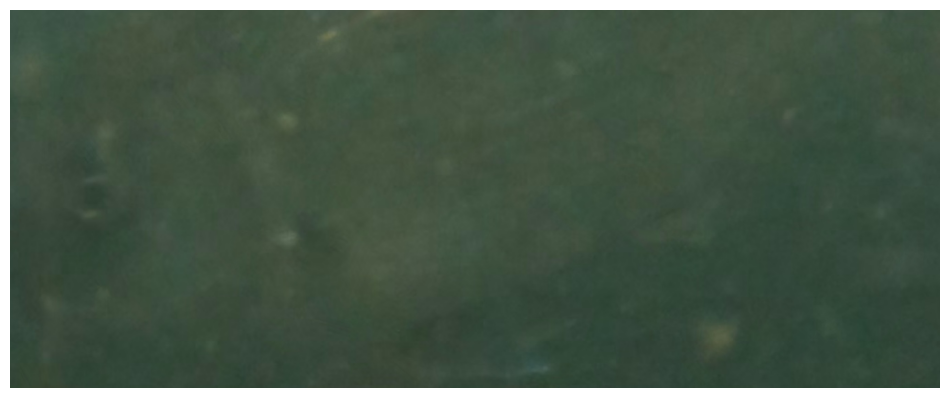

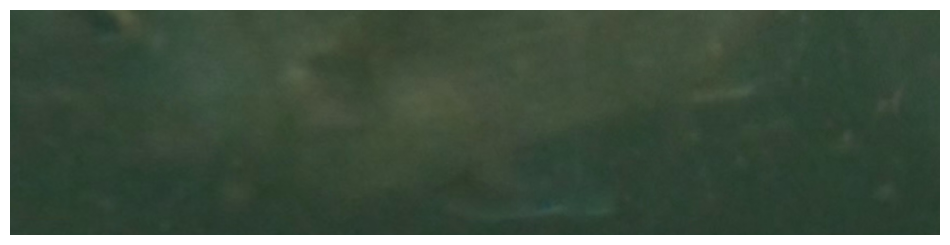

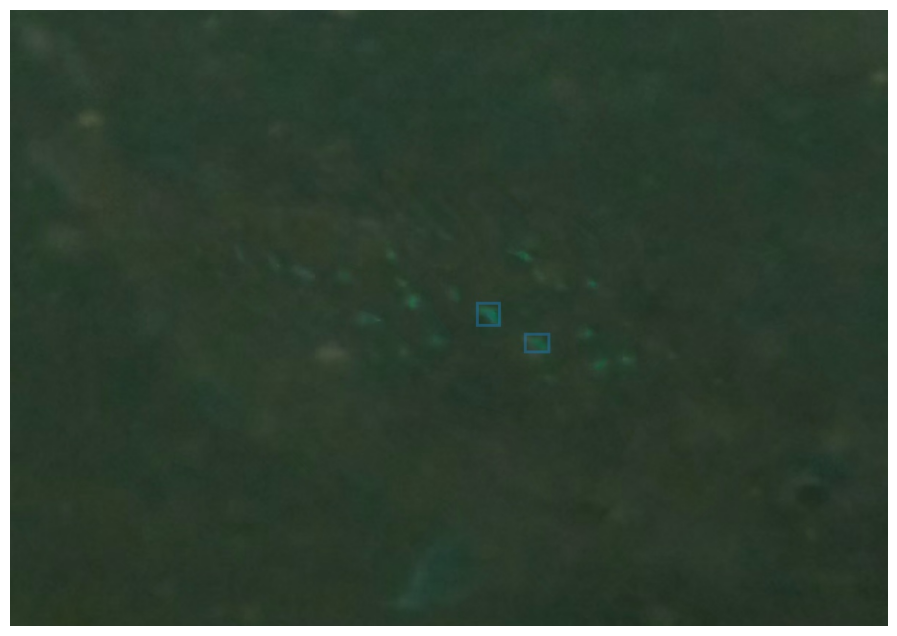

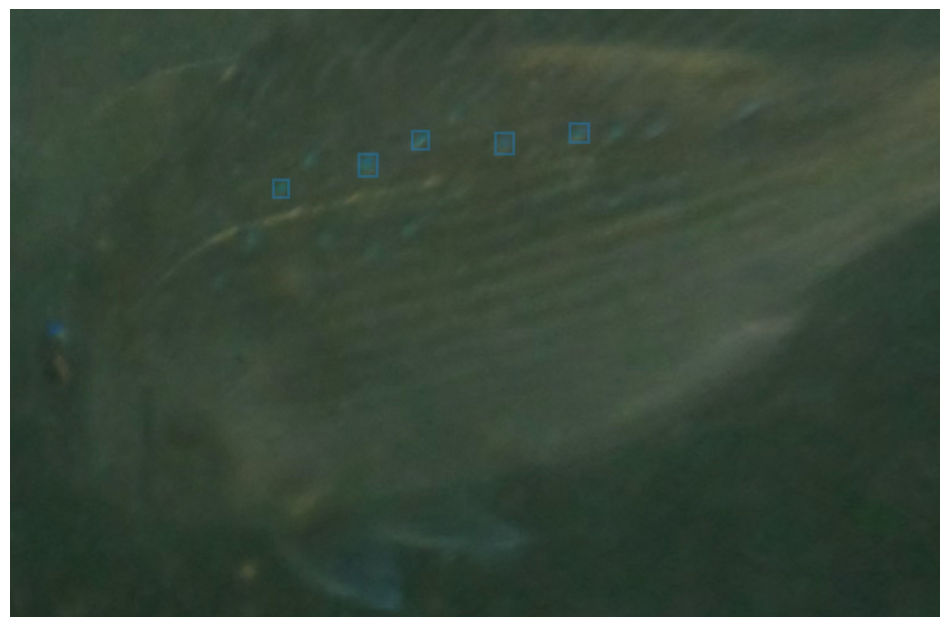

murky dim gopro
Best images:


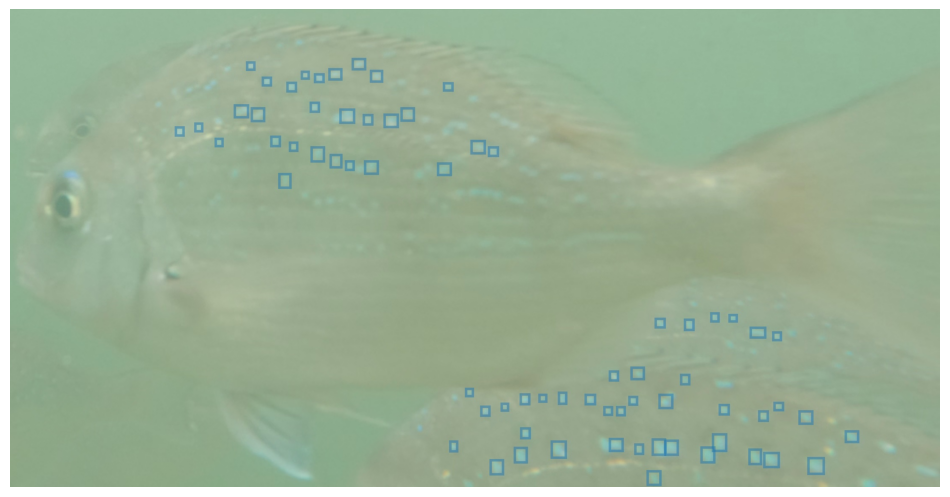

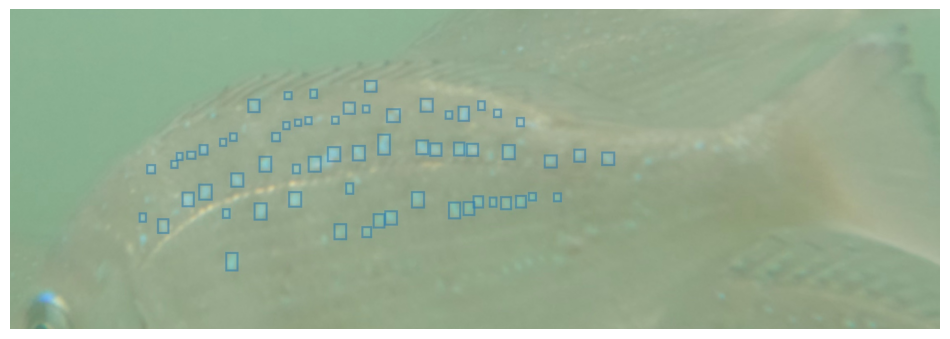

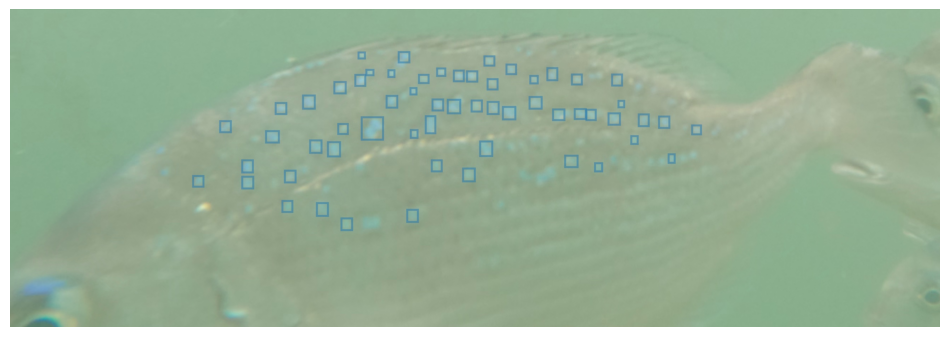

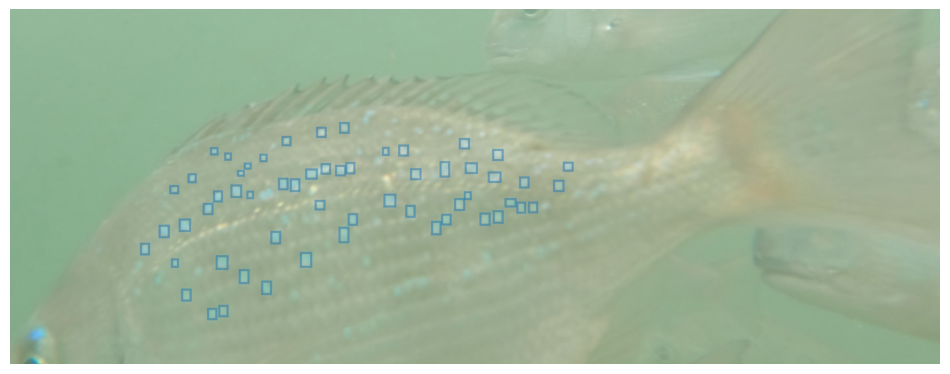

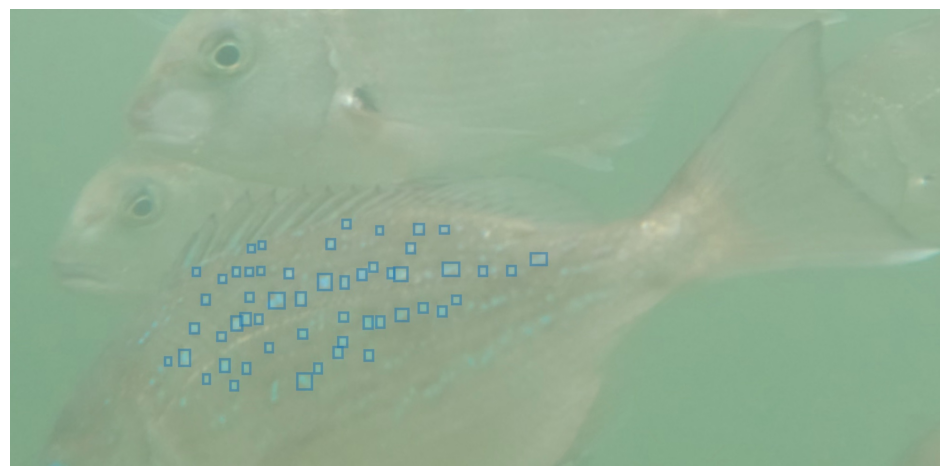

Random images:


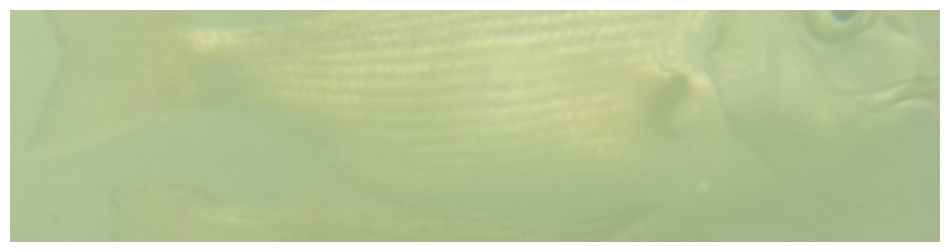

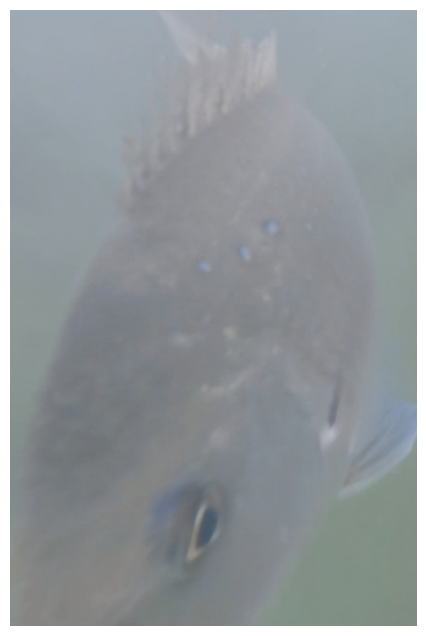

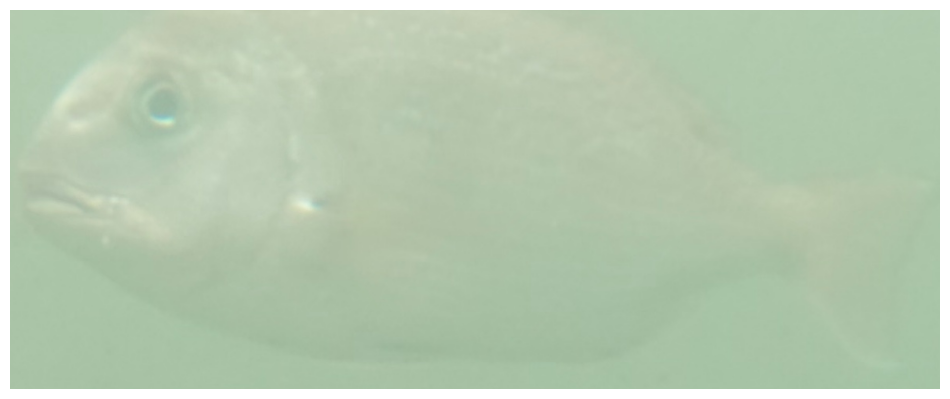

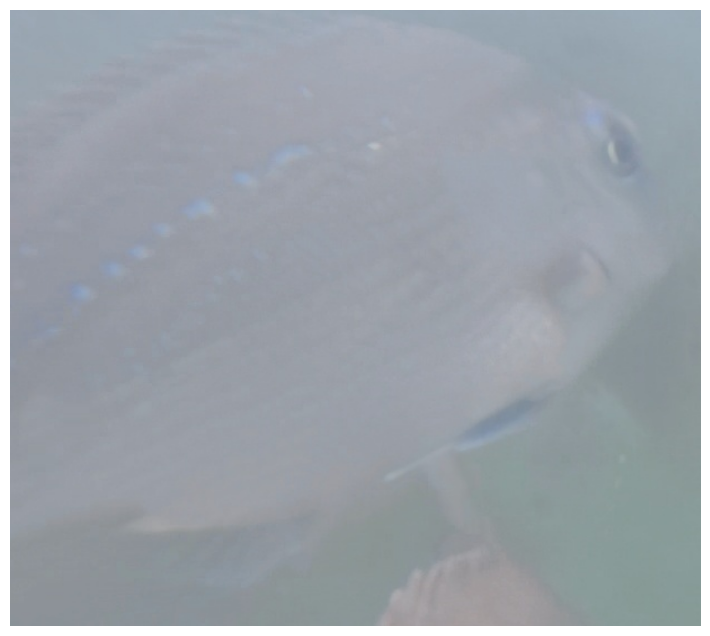

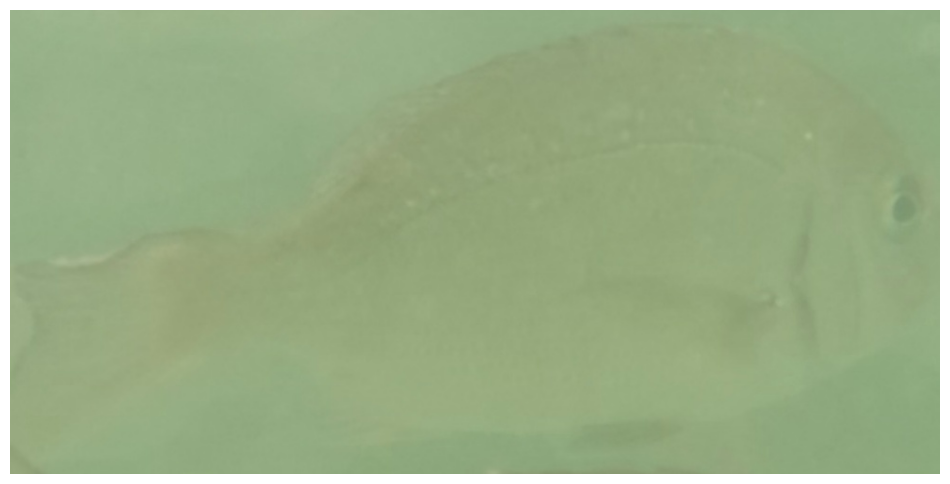

murky dim phone
Best images:


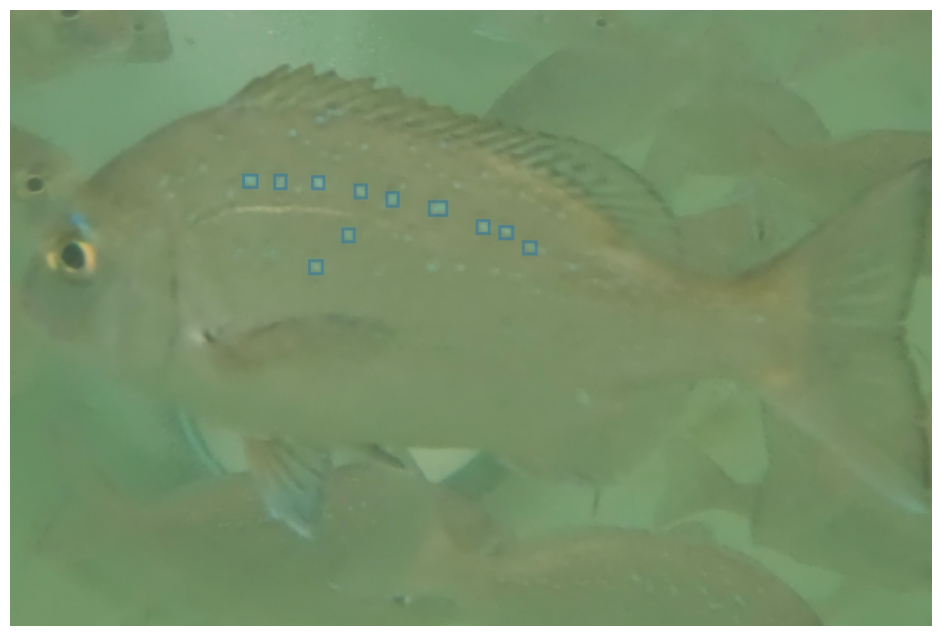

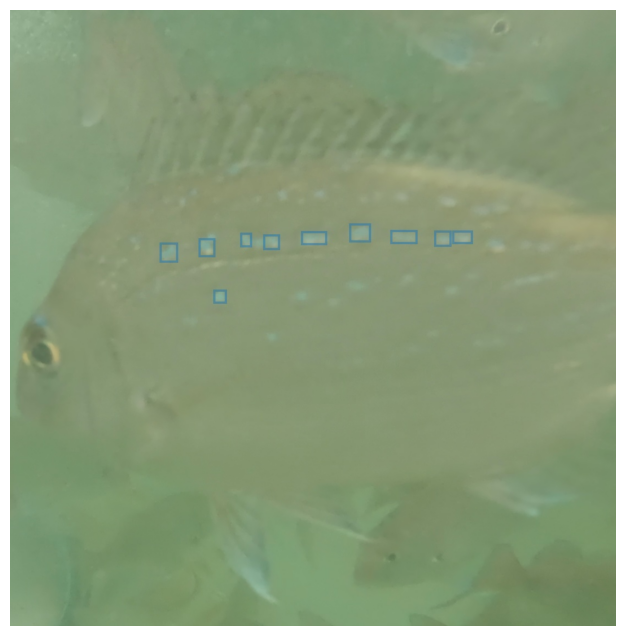

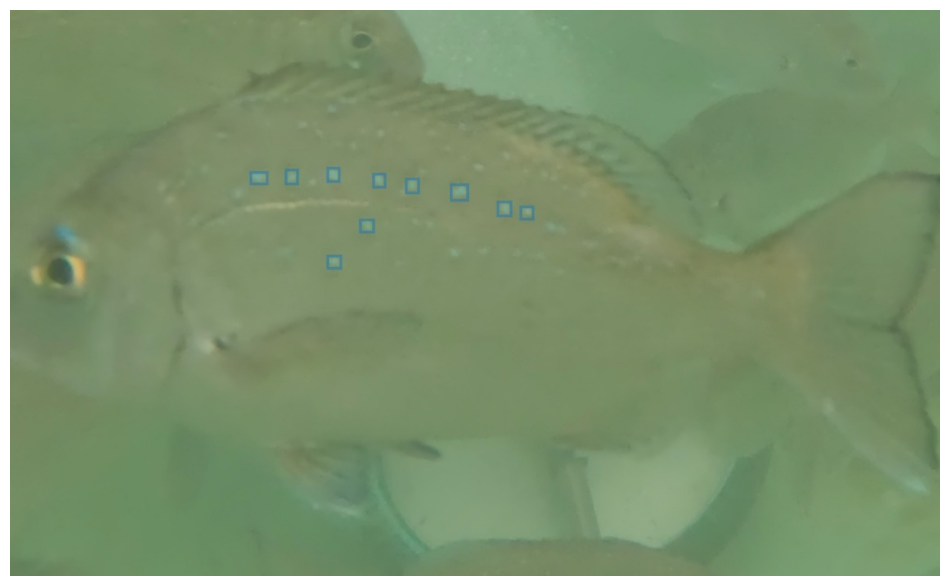

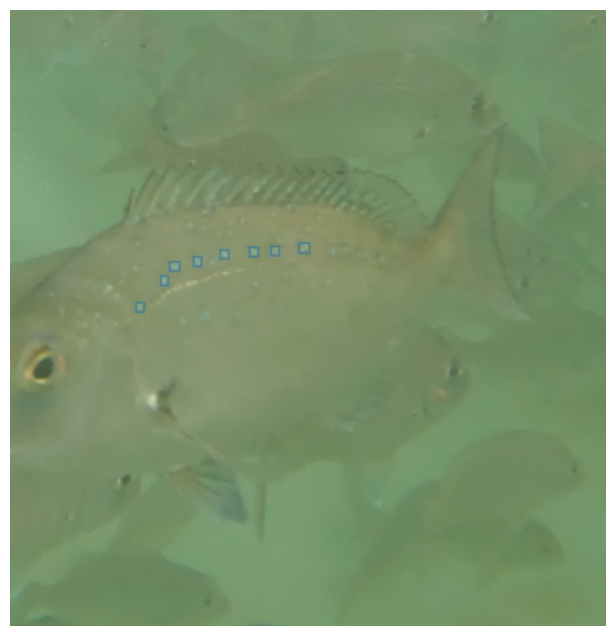

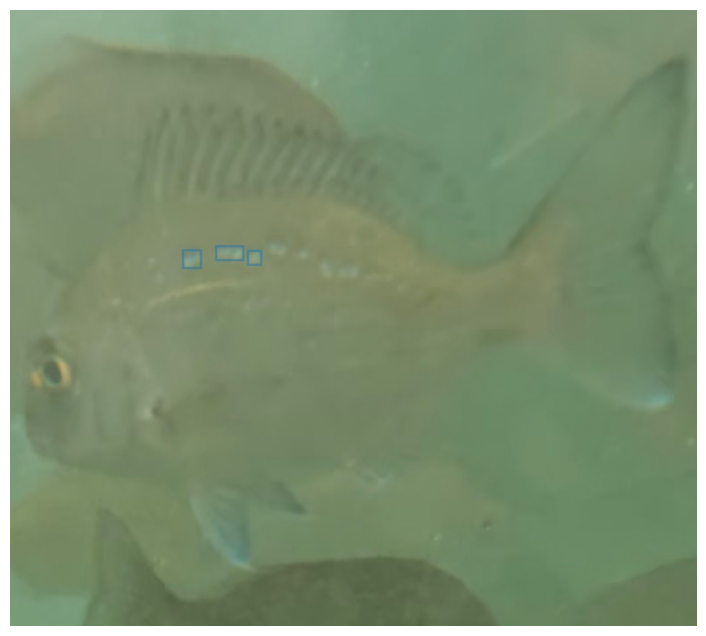

Random images:


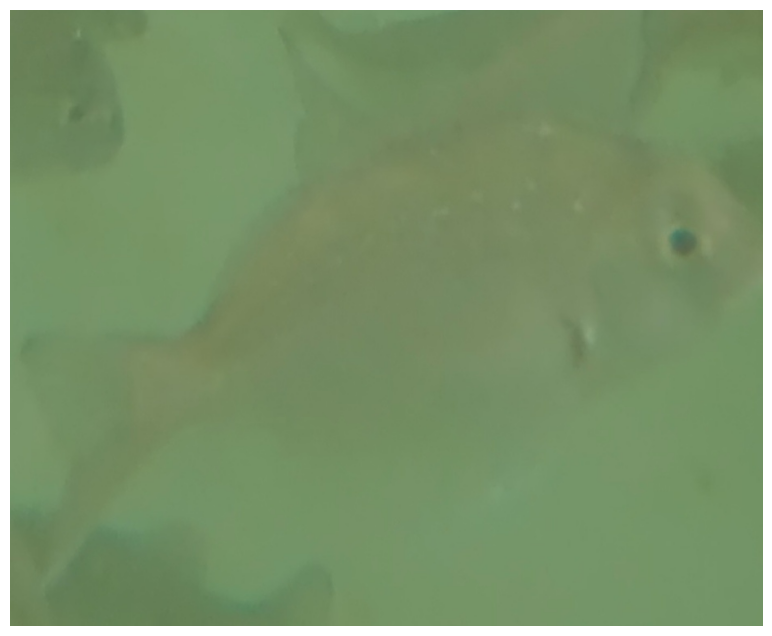

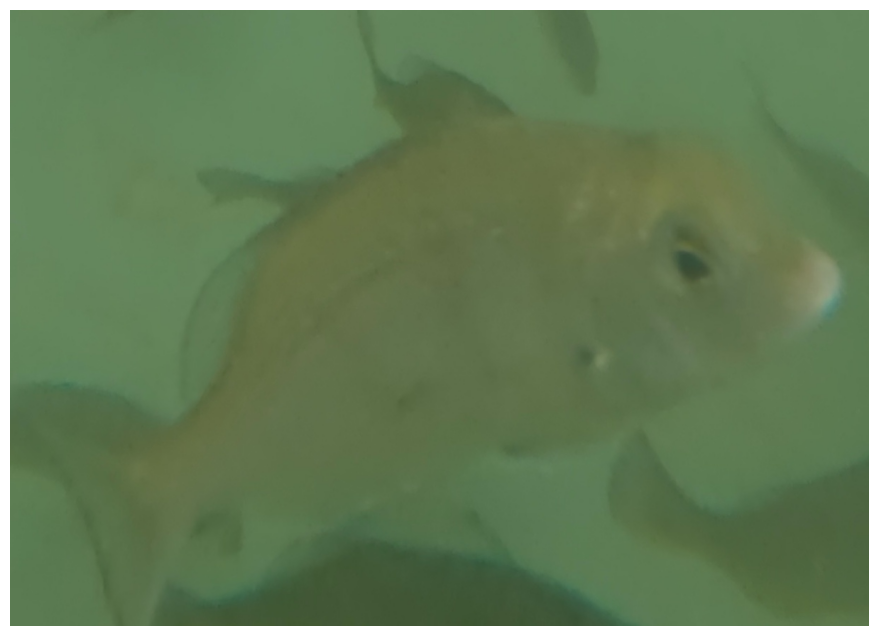

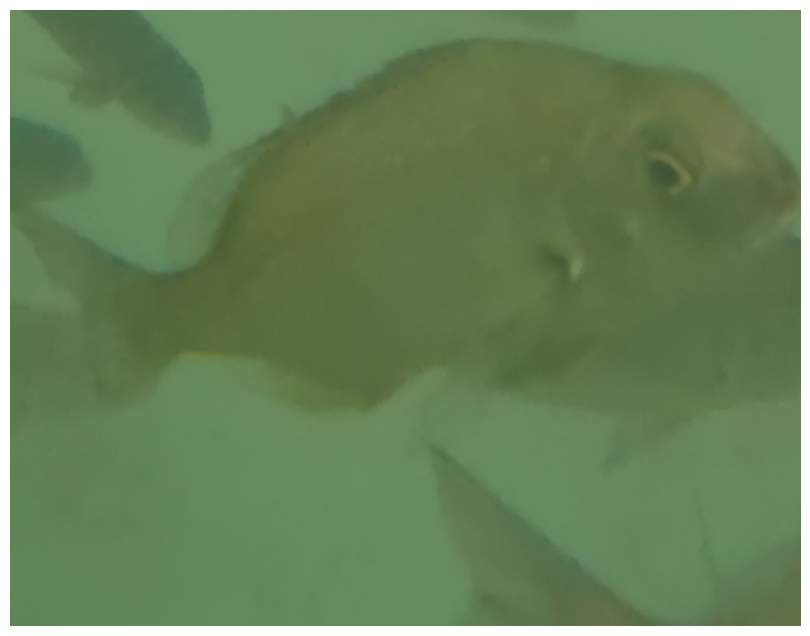

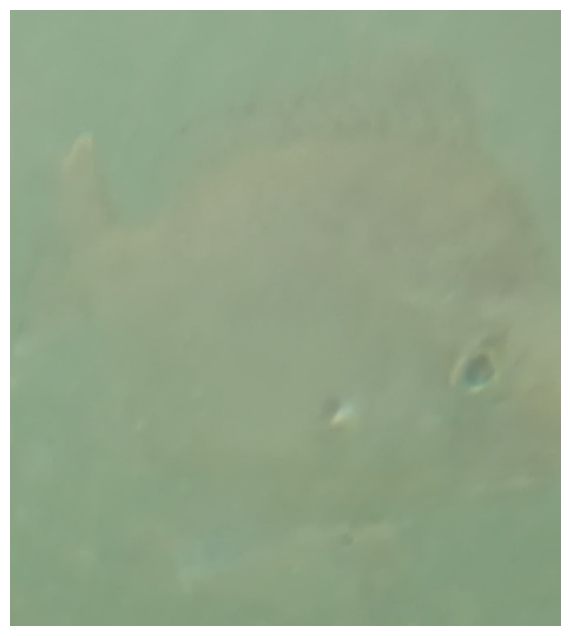

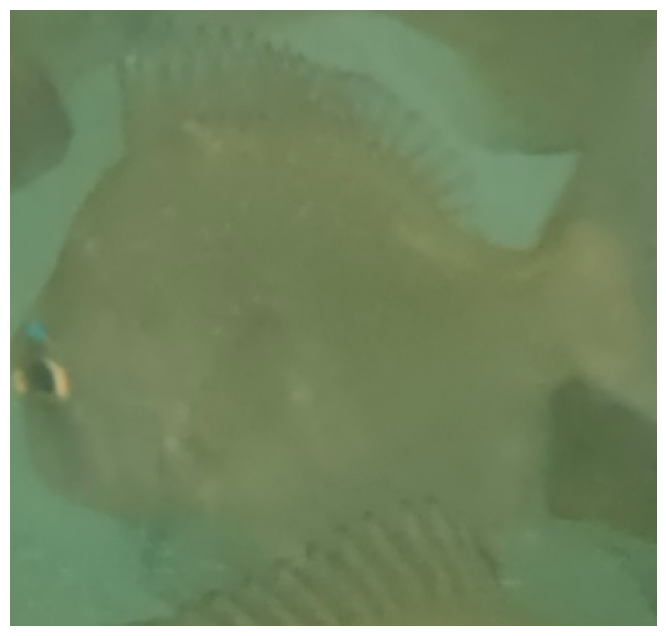

In [38]:
groups = obs_df_aggregated.sort_values(["NumSpots", "ObservationAreaPx"], ascending=False).groupby(["WaterQuality", "Brightness", "Camera"])
for (water_quality, brightness, camera), df in groups:
    print(water_quality, brightness, camera)
    print("Best images:")
    for index, row in df.head(5).iterrows():
        image_path = Path(row["ObservationPath"]).with_suffix("")
        image = cv.imread(str(image_path))
        plt.imshow(image[:,:,::-1])
        plt.axis("off")
        plt.show()
    print("Random images:")
    for index, row in df.sample(5).iterrows():
        image_path = Path(row["ObservationPath"]).with_suffix("")
        image = cv.imread(str(image_path))
        plt.imshow(image[:,:,::-1])
        plt.axis("off")
        plt.show()
    